In [1]:
!pip install scienceplots

In [2]:
import seaborn as sns
import pandas as pd
import numpy as np
import re
from datetime import datetime
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from sklearn.manifold import TSNE
import requests
import math
import os
import scienceplots


from sklearn.preprocessing import StandardScaler

In [3]:
plt.style.use(["science","notebook","grid"])

https://www.geeksforgeeks.org/python/python-seaborn-tutorial/


In [4]:
import requests

# Configuraciones
url = "https://ssd-api.jpl.nasa.gov/cad.api"
params_base = {
    "date-min": "1900-01-01",
    "date-max": "2100-01-01",
    "dist-max": "10",  # 10 AU cubre mucho más
    "limit": 100000,
    "fullname": "true"
}

all_data = []
start = 1
while True:
    params = params_base.copy()
    params["limit-from"] = start
    response = requests.get(url, params=params)
    dataapi = response.json()

    # Extraer registros
    rows = dataapi.get('data', [])
    if not rows:
        break  # No hay más registros

    all_data.extend(rows)
    print(f"{len(all_data)} registros descargados...")

    if len(rows) < 100000:
        break  # Ya no quedan más

    start += 100000

# Convertir todo en DataFrame
columns = dataapi['fields']
dfapi = pd.DataFrame(all_data, columns=columns)

# # Guardar CSV
# dfapi.to_csv("asteroid_all_approaches.csv", index=False)

100000 registros descargados...
200000 registros descargados...
300000 registros descargados...
400000 registros descargados...
500000 registros descargados...
538922 registros descargados...


In [ ]:
fecha_hoy = datetime.utcnow().strftime('%Y-%m-%d')  # fecha actual en formato AAAA-MM-DD (UTC)
url = f"https://ssd-api.jpl.nasa.gov/cad.api?date-min=1900-01-01&date-max={fecha_hoy}&dist-max=0.05"

respuesta = requests.get(url)
if respuesta.status_code != 200:
    raise Exception(f"Error al obtener datos de la API: {respuesta.status_code}")

datos_json = respuesta.json()

columnas = datos_json.get('fields', [])
datos = datos_json.get('data', [])
df = pd.DataFrame(data=datos, columns=columnas)

columnas_relevantes = ["des", "cd", "dist", "dist_min", "v_rel", "v_inf", "h"]
df = df[columnas_relevantes].copy()

df["dist"] = pd.to_numeric(df["dist"], errors='coerce')
df["dist_min"] = pd.to_numeric(df["dist_min"], errors='coerce')
df["v_rel"] = pd.to_numeric(df["v_rel"], errors='coerce')
df["v_inf"] = pd.to_numeric(df["v_inf"], errors='coerce')
df["h"] = pd.to_numeric(df["h"], errors='coerce')

factor_albedo = 1329 / math.sqrt(0.14)
df["diameter"] = factor_albedo * (10 ** (-0.2 * df["h"]))

def clasificar_rareza(fila):
    dist = fila["dist"]
    diam = fila["diameter"]
    if dist < 0.001:
        dist_cat = 4
    elif dist < 0.005:
        dist_cat = 3
    elif dist < 0.01:
        dist_cat = 2
    elif dist < 0.02:
        dist_cat = 1
    else:
        dist_cat = 0
    if diam >= 1:  # >= 1 km (objeto muy grande)
        size_cat = 4
    elif diam >= 0.14:  # >= 0.14 km (~140 m)
        size_cat = 3
    elif diam >= 0.05:   # >= 0.05 km (~50 m)
        size_cat = 2
    elif diam >= 0.01:   # >= 0.01 km (~10 m)
        size_cat = 1
    else:
        size_cat = 0
    if size_cat <= 1:
        rareza = 1 if dist_cat >= 1 else 0
    else:
        if size_cat >= 3 and dist_cat >= 3:
            rareza = 4  # tamaño y distancia muy significativos -> muy raro
        elif size_cat >= 4 or dist_cat >= 4:
            rareza = 4  # cualquiera de los dos factores en extremo -> muy raro
        elif size_cat == 2 and dist_cat >= 4:
            rareza = 3  # objeto mediano extremadamente cerca -> raro
        elif size_cat >= 3 and dist_cat == 2:
            rareza = 3  # objeto grande a distancia moderada -> raro
        elif size_cat == 2 and dist_cat == 3:
            rareza = 2  # objeto mediano muy cerca -> infrecuente
        else:
            rareza = max(size_cat, dist_cat)
            if rareza > 4:
                rareza = 4
    return rareza

df["rareza"] = df.apply(clasificar_rareza, axis=1)

df = df.rename(columns={
    "des": "Object",
    "cd": "Close-Approach (CA) Date",
    "dist": "CA DistanceNominal (au)",
    "dist_min": "CA DistanceMinimum (au)",
    "v_rel": "V relative(km/s)",
    "v_inf": "V infinity(km/s)",
    "h": "H(mag)",
    "diameter": "Diameter",
    "rareza": "Rarity"
})

ruta_csv = "near_approaches.csv"
df.to_csv(ruta_csv, index=False)
print(f"Archivo CSV guardado en {ruta_csv} con {len(df)} registros de acercamientos cercanos.")

C:\Users\Usuario\AppData\Local\Temp\ipykernel_22408\1893072765.py:1: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  fecha_hoy = datetime.utcnow().strftime('%Y-%m-%d')  # fecha actual en formato AAAA-MM-DD (UTC)


OSError: Cannot save file into a non-existent directory: '\Usuario\Desktop\Proyecto semillero'

In [ ]:
# dfapi

In [ ]:
Ne= pd.read_csv('near_approaches.csv')
Ne

# Contenido:

# Object: Nombre del NEO
# Close-Approach (CA) Date: Fecha de el momento en que el NEO paso mas cerca de la tierra
# CA DistanceNominal(au):  Es la distancia promedio entre el asteroide y la Tierra
# CA DistanceMinimum (au): Es la menor distancia posible a la que el asteroide podría pasar. Se usa cuando hay un poco de duda en la trayectoria exacta.
# V relative(km/s): Es la velocidad del asteroide cuando pasa cerca de la Tierra. Se mide en kilómetros por segundo.
# V infinity(km/s): Es la velocidad del asteroide cuando está lejos de la Tierra, sin la influencia de nuestra gravedad.
# H(mag): Es el brillo del asteroide. Un número más bajo significa que el asteroide es más brillante y probablemente más grande.
# Diameter: Es la medida del diametro del asteroide
# Rarity: La variable Rarity indica la rareza de un evento de aproximación cercana de un objeto a la Tierra, clasificada en una escala de 0 a 4.
# dist_cat = 4 (muy cercano)
# dist_cat = 3
# dist_cat = 2
# dist_cat = 1
# dist_cat = 0 (la más lejana dentro de "cercano")


,Object,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity
0,509352,1900-Jan-04 22:25,0.009632,0.009625,8.686710,8.654806,20.160,0.329960,3
1,2014 SC324,1900-Jan-11 01:07,0.039964,0.039904,10.652382,10.646122,24.390,0.047039,0
2,2012 UK171,1900-Jan-12 23:02,0.049706,0.049578,7.153496,7.145999,24.460,0.045547,0
3,2024 BA5,1900-Jan-25 06:22,0.026434,0.011310,8.436204,8.424247,26.020,0.022206,0
4,2024 BW1,1900-Jan-25 19:29,0.037979,0.010125,6.339787,6.328711,25.120,0.033609,0
...,...,...,...,...,...,...,...,...,...
31329,2026 BJ8,2026-Feb-12 04:56,0.025494,0.025364,11.238300,11.228997,25.003,0.035470,0
31330,2026 CW1,2026-Feb-12 10:58,0.009502,0.009409,18.416534,18.401301,27.058,0.013768,1
31331,2026 CV,2026-Feb-12 13:18,0.035231,0.034968,10.347992,10.340681,25.904,0.023424,0
31332,2022 DV,2026-Feb-12 23:08,0.039493,0.026072,5.004609,4.991110,26.530,0.017557,0


In [ ]:
Ne.isna().sum()

,0
Object,0
Close-Approach (CA) Date,0
CA DistanceNominal (au),0
CA DistanceMinimum (au),0
V relative(km/s),0
V infinity(km/s),18
H(mag),8
Diameter,8
Rarity,0


In [ ]:
#def procesar_diametro(diametro):

 #    diametro = diametro.strip().lower()

  #   en_kilometros = 'km' in diametro

   #  diametro = re.sub(r'[^\d.\s-]', '', diametro)

    # valores = re.findall(r'(\d+\.?\d*)', diametro)

     #if len(valores) == 2:
        # min_valor, max_valor = map(float, valores)
       #  promedio = (min_valor + max_valor) / 2
     #elif len(valores) == 1:
         #promedio = float(valores[0])
     #else:
      #   return None

     #if en_kilometros:
      #   promedio *= 1000

     #return promedio

 #Ne['Diameter'] = Ne['Diameter'].apply(procesar_diametro)
 #Ne

In [ ]:
def limpiar_fecha(fecha):
    fecha_limpia = re.sub(r'\s±.*', '', fecha)
    fecha_limpia = re.sub(r'[()]', '', fecha_limpia).strip()
    try:
        return datetime.strptime(fecha_limpia, '%Y-%b-%d %H:%M')
    except ValueError:
        return None


Ne['Close-Approach (CA) Date'] = Ne['Close-Approach (CA) Date'].apply(limpiar_fecha)

Ne


,Object,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity
0,509352,1900-01-04 22:25:00,0.009632,0.009625,8.686710,8.654806,20.160,0.329960,3
1,2014 SC324,1900-01-11 01:07:00,0.039964,0.039904,10.652382,10.646122,24.390,0.047039,0
2,2012 UK171,1900-01-12 23:02:00,0.049706,0.049578,7.153496,7.145999,24.460,0.045547,0
3,2024 BA5,1900-01-25 06:22:00,0.026434,0.011310,8.436204,8.424247,26.020,0.022206,0
4,2024 BW1,1900-01-25 19:29:00,0.037979,0.010125,6.339787,6.328711,25.120,0.033609,0
...,...,...,...,...,...,...,...,...,...
31329,2026 BJ8,2026-02-12 04:56:00,0.025494,0.025364,11.238300,11.228997,25.003,0.035470,0
31330,2026 CW1,2026-02-12 10:58:00,0.009502,0.009409,18.416534,18.401301,27.058,0.013768,1
31331,2026 CV,2026-02-12 13:18:00,0.035231,0.034968,10.347992,10.340681,25.904,0.023424,0
31332,2022 DV,2026-02-12 23:08:00,0.039493,0.026072,5.004609,4.991110,26.530,0.017557,0


In [ ]:
def velocidad_escape():
    G = 6.67430e-11  # Constante gravitacional en m^3 / (kg·s^2)
    masa_tierra = 5.972e24       # kg

    radio_tierra = 6.371e6
    v_escape = (math.sqrt((2 * G * masa_tierra) / radio_tierra))/1000
    return v_escape


In [ ]:


# Velocidad de escape (km/s)
v_esc = velocidad_escape()

# Máscara: valores nulos en 'V infinity(km/s)'
mask_nan = Ne['V infinity(km/s)'].isna()

# Máscara: nulos que cumplen con la condición física
mask_valid = mask_nan & ((Ne['V relative(km/s)']**2 - v_esc**2) >= 0)

# Imputar con la fórmula física
Ne.loc[mask_valid, 'V infinity(km/s)'] = np.sqrt(
    Ne.loc[mask_valid, 'V relative(km/s)']**2 - v_esc**2
)

# Imputar con la media para los que no cumplen la condición física
mask_invalid = mask_nan & ((Ne['V relative(km/s)']**2 - v_esc**2) < 0)
Ne.loc[mask_invalid, 'V infinity(km/s)'] = Ne['V infinity(km/s)'].mean()




In [ ]:
Ne.isna().sum()

,0
Object,0
Close-Approach (CA) Date,0
CA DistanceNominal (au),0
CA DistanceMinimum (au),0
V relative(km/s),0
V infinity(km/s),0
H(mag),8
Diameter,8
Rarity,0


In [ ]:
Ne.dropna(subset=['H(mag)', 'Diameter'], inplace=True)

Ne.isna().sum()

,0
Object,0
Close-Approach (CA) Date,0
CA DistanceNominal (au),0
CA DistanceMinimum (au),0
V relative(km/s),0
V infinity(km/s),0
H(mag),0
Diameter,0
Rarity,0


In [ ]:
data = Ne.sort_values(by='Close-Approach (CA) Date', ascending=False)
data

,Object,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity
31333,2026 CT1,2026-02-12 23:45:00,0.028676,0.028484,7.045972,7.032772,26.184,0.020590,0
31332,2022 DV,2026-02-12 23:08:00,0.039493,0.026072,5.004609,4.991110,26.530,0.017557,0
31331,2026 CV,2026-02-12 13:18:00,0.035231,0.034968,10.347992,10.340681,25.904,0.023424,0
31330,2026 CW1,2026-02-12 10:58:00,0.009502,0.009409,18.416534,18.401301,27.058,0.013768,1
31329,2026 BJ8,2026-02-12 04:56:00,0.025494,0.025364,11.238300,11.228997,25.003,0.035470,0
...,...,...,...,...,...,...,...,...,...
4,2024 BW1,1900-01-25 19:29:00,0.037979,0.010125,6.339787,6.328711,25.120,0.033609,0
3,2024 BA5,1900-01-25 06:22:00,0.026434,0.011310,8.436204,8.424247,26.020,0.022206,0
2,2012 UK171,1900-01-12 23:02:00,0.049706,0.049578,7.153496,7.145999,24.460,0.045547,0
1,2014 SC324,1900-01-11 01:07:00,0.039964,0.039904,10.652382,10.646122,24.390,0.047039,0


In [ ]:
X = data[["CA DistanceNominal (au)","CA DistanceMinimum (au)", "V relative(km/s)", "V infinity(km/s)","H(mag)", "Diameter","Rarity"]]

scaler = StandardScaler()
Xscaled = scaler.fit_transform(X)
kmeans = KMeans(n_clusters=5, random_state=42)
data["Cluster"] = kmeans.fit_predict(Xscaled)
print(data[["Object", "Cluster"]].head())

         Object  Cluster
31333  2026 CT1        4
31332   2022 DV        4
31331   2026 CV        1
31330  2026 CW1        2
31329  2026 BJ8        1


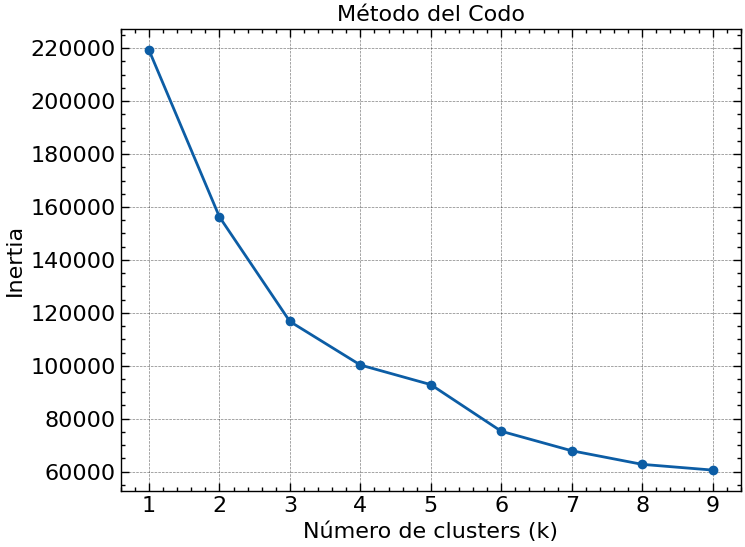

In [ ]:

inertia = []
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(Xscaled)
    inertia.append(kmeans.inertia_)

plt.plot(range(1, 10), inertia, marker='o')
plt.xlabel('Número de clusters (k)')
plt.ylabel('Inertia')
plt.title('Método del Codo')
plt.show()

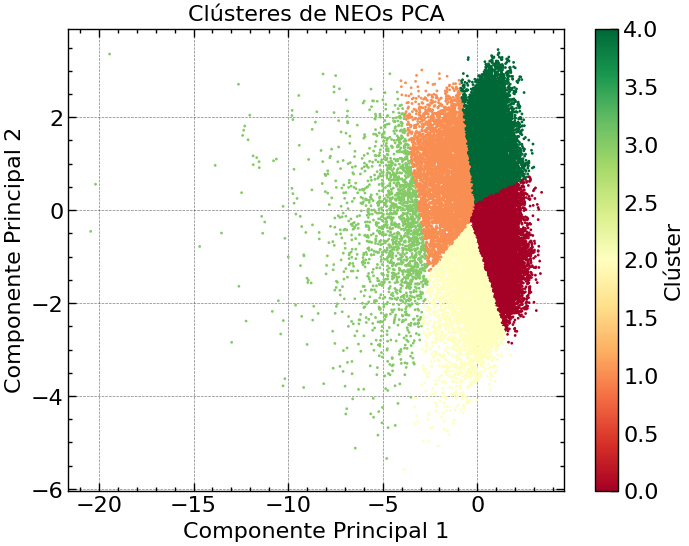

In [ ]:
Xax = pd.DataFrame(Xscaled)

pca = PCA(n_components=2)
pcaresult = pca.fit_transform(Xax)
kmeans = KMeans(n_clusters=5, random_state=42)
clusters = kmeans.fit_predict(pcaresult)
data_numerica = Xax.copy()
data_numerica['PCA1'] = pcaresult[:, 0]
data_numerica['PCA2'] = pcaresult[:, 1]
data_numerica['Cluster'] = clusters

plt.figure(figsize=(8, 6))
plt.scatter(data_numerica['PCA1'], data_numerica['PCA2'], c=data_numerica['Cluster'], cmap='RdYlGn', s=1)
plt.title('Clústeres de NEOs PCA')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.colorbar(label='Clúster')
plt.grid(True)
plt.show()


In [ ]:
# Group the original data by the 'Cluster' column (from K-Means on PCA)
# and display descriptive statistics for each cluster
for cluster_id in sorted(data['Cluster'].unique()):
    print(f"Cluster {cluster_id} Description:")
    display(data[data['Cluster'] == cluster_id].describe())
    print("\n" + "="*50 + "\n")

Cluster 0 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster
count,9133,9133.000000,9133.000000,9133.000000,9133.000000,9133.000000,9133.000000,9133.000000,9133.0
mean,2002-03-30 22:46:20.805868672,0.011576,0.009467,7.783785,7.711233,26.896070,0.020079,1.006351,0.0
min,1900-01-25 06:22:00,0.000044,0.000000,0.650095,0.216022,21.340000,0.000553,0.000000,0.0
25%,1992-04-22 00:32:00,0.005793,0.004166,6.000425,5.939892,25.900000,0.009342,1.000000,0.0
50%,2017-10-22 07:41:00,0.011322,0.009083,7.947557,7.873206,26.930000,0.014604,1.000000,0.0
75%,2022-07-03 15:05:00,0.016574,0.014373,9.735210,9.683681,27.900000,0.023467,1.000000,0.0
max,2026-02-09 05:09:00,0.042146,0.027127,13.588128,13.081624,34.037000,0.191629,4.000000,0.0
std,NaN,0.007020,0.005984,2.515896,2.524601,1.682768,0.018156,0.376085,0.0




Cluster 1 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster
count,4624,4624.000000,4624.000000,4624.000000,4624.000000,4624.000000,4624.000000,4624.000000,4624.0
mean,1995-01-02 08:32:05.255190272,0.033251,0.026656,12.713359,12.706223,25.723661,0.028204,0.003244,1.0
min,1900-01-11 01:07:00,0.018701,0.000013,8.101183,8.091240,24.260000,0.001020,0.000000,1.0
25%,1971-09-14 06:34:45,0.025969,0.020707,10.571529,10.563746,24.900000,0.019519,0.000000,1.0
50%,2014-08-29 15:37:00,0.032443,0.026786,12.063356,12.057665,25.500000,0.028214,0.000000,1.0
75%,2021-11-09 04:14:00,0.040054,0.034368,14.213943,14.209003,26.300000,0.037193,0.000000,1.0
max,2026-02-12 13:18:00,0.049992,0.049991,29.877613,29.875407,32.710000,0.049941,1.000000,1.0
std,NaN,0.008391,0.011164,2.948712,2.950457,1.088568,0.011193,0.056869,0.0




Cluster 2 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster
count,3725,3725.000000,3.725000e+03,3725.000000,3725.000000,3725.000000,3725.000000,3725.000000,3725.0
mean,2007-10-15 08:50:57.809395968,0.010961,9.175983e-03,16.830463,16.777070,26.188502,0.028203,1.080268,2.0
min,1900-02-27 07:57:00,0.000045,3.394972e-07,11.410125,11.385502,20.740000,0.000814,0.000000,2.0
25%,2009-11-22 03:08:00,0.004466,3.431755e-03,13.697511,13.620472,25.000000,0.012316,1.000000,2.0
50%,2019-06-02 20:41:00,0.009920,7.969499e-03,15.596036,15.539342,26.150000,0.020915,1.000000,2.0
75%,2022-12-26 07:59:00,0.016135,1.412119e-02,18.761122,18.694839,27.300000,0.035519,1.000000,2.0
max,2026-02-12 10:58:00,0.046200,4.364582e-02,40.190937,40.186533,33.200000,0.252616,4.000000,2.0
std,NaN,0.007787,6.660323e-03,4.211105,4.219564,1.773617,0.024812,0.471816,0.0




Cluster 3 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster
count,5495,5495.000000,5495.000000,5495.000000,5495.000000,5495.000000,5495.000000,5495.000000,5495.0
mean,1975-08-06 19:33:33.750682400,0.035344,0.034104,14.266693,14.259431,21.775188,0.233670,2.527753,3.0
min,1900-01-04 22:25:00,0.000503,0.000148,2.712656,2.691730,14.080000,0.050172,2.000000,3.0
25%,1940-10-05 04:25:00,0.028788,0.027189,10.099337,10.093228,20.660000,0.080253,2.000000,3.0
50%,1982-06-30 00:02:00,0.036662,0.035426,13.123810,13.116442,22.030000,0.139464,2.000000,3.0
75%,2013-02-02 16:11:30,0.043707,0.042852,17.245041,17.240795,23.230000,0.262096,3.000000,3.0
max,2026-02-05 00:22:00,0.050000,0.049999,40.672808,40.670955,24.250000,5.425765,4.000000,3.0
std,NaN,0.010131,0.010652,5.626761,5.629089,1.762968,0.306487,0.552572,0.0




Cluster 4 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster
count,8349,8349.000000,8349.000000,8349.000000,8349.000000,8349.000000,8349.000000,8349.000000,8349.0
mean,1991-01-01 07:48:00.927057152,0.036276,0.032833,6.196325,6.182327,26.055614,0.026206,0.141813,4.0
min,1900-01-12 23:02:00,0.020018,0.000136,0.275869,0.125474,22.300000,0.000913,0.000000,4.0
25%,1965-04-03 12:02:00,0.029465,0.025687,4.743673,4.728238,25.100000,0.015013,0.000000,4.0
50%,2008-08-03 20:15:00,0.036787,0.033065,6.327423,6.318725,25.990000,0.022514,0.000000,4.0
75%,2020-09-16 21:22:00,0.043221,0.040446,7.754016,7.742816,26.870000,0.033920,0.000000,4.0
max,2026-02-12 23:45:00,0.049996,0.049987,11.048117,11.043257,32.950000,0.123158,2.000000,4.0
std,NaN,0.008248,0.009617,2.036704,2.044121,1.373500,0.015980,0.513369,0.0


Pair plot for Cluster 0:


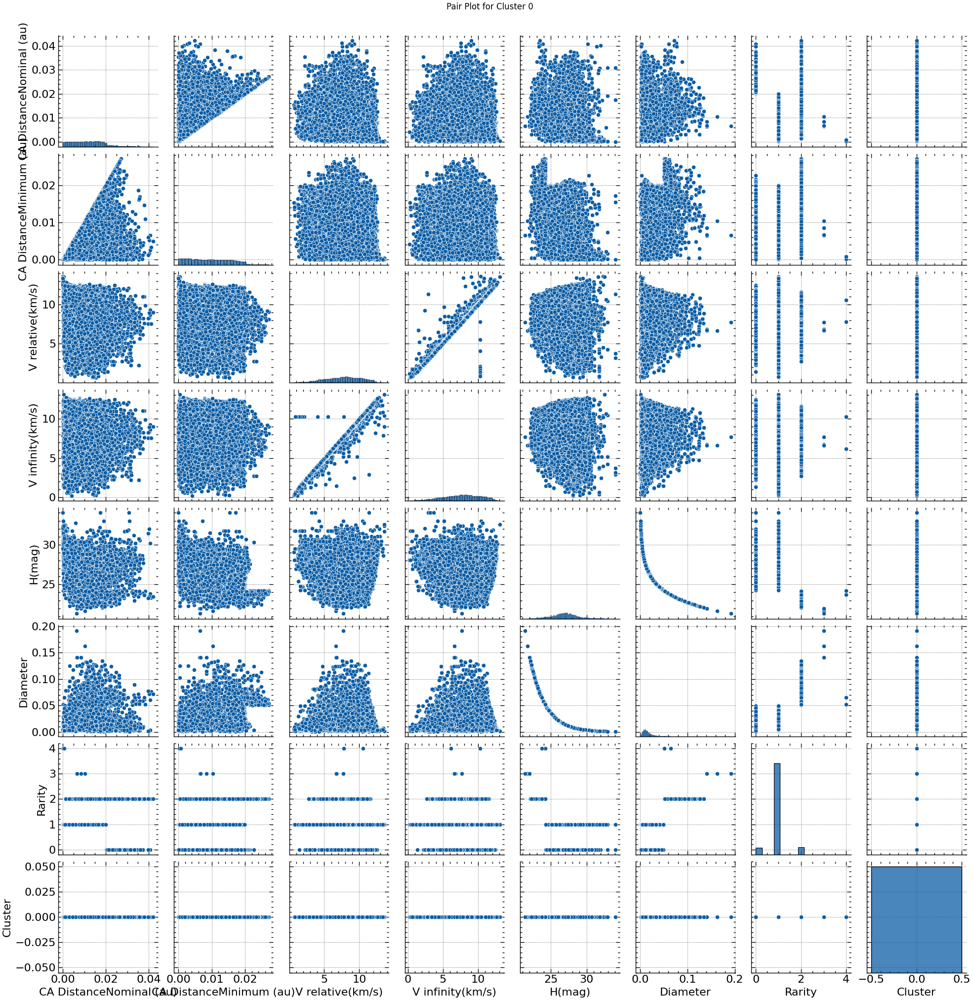



Pair plot for Cluster 1:


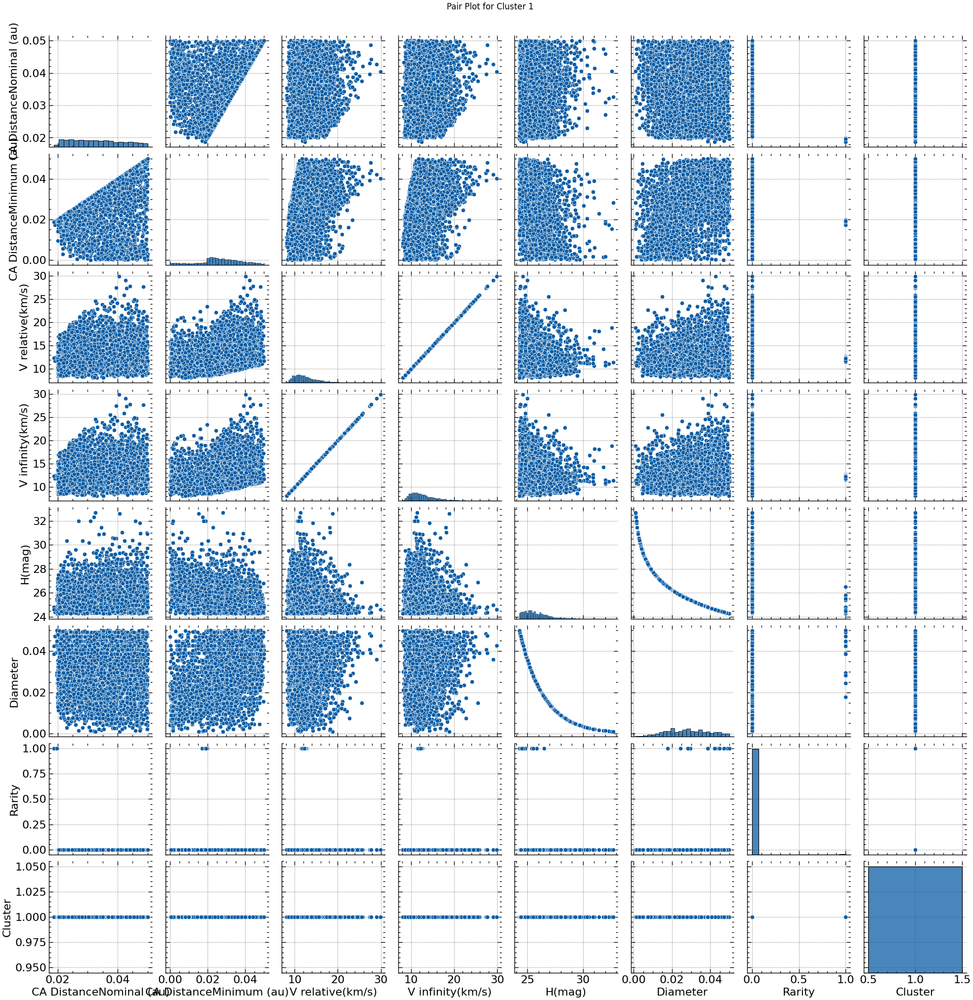



Pair plot for Cluster 2:


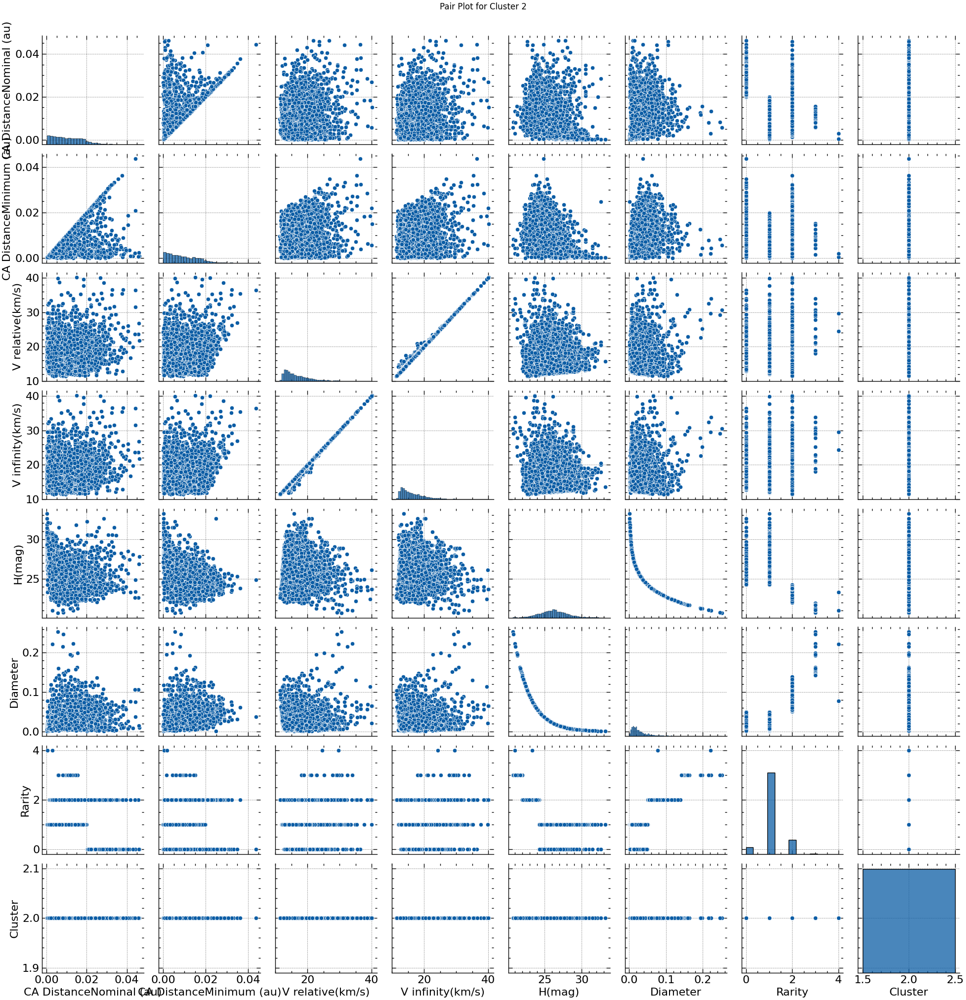



Pair plot for Cluster 3:


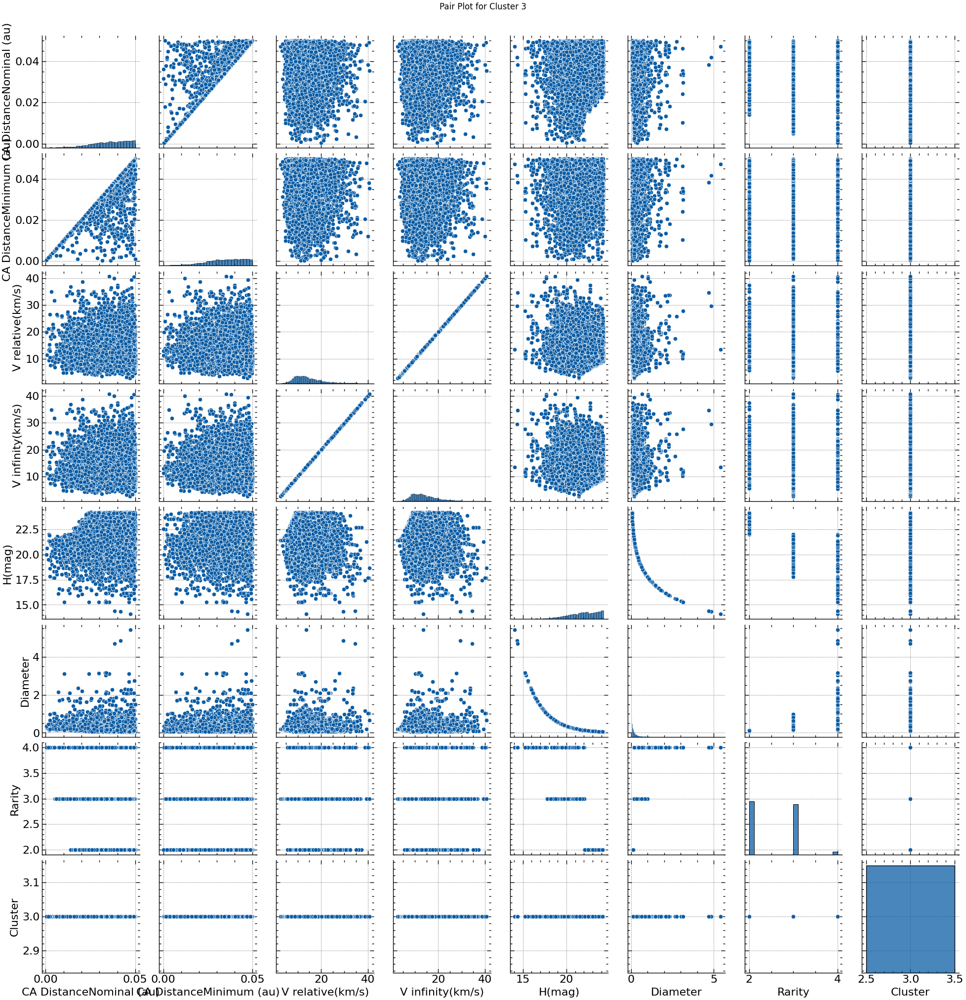



Pair plot for Cluster 4:


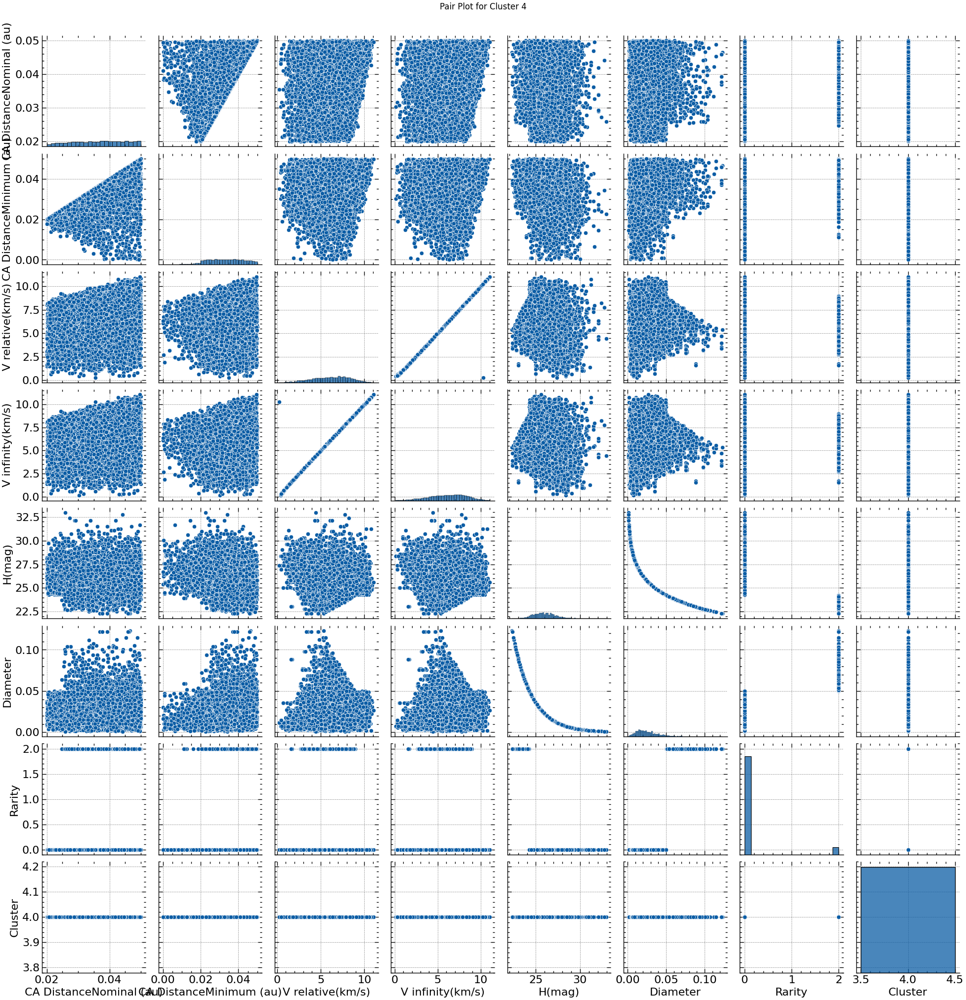

In [ ]:
for cluster_id in sorted(data['Cluster'].unique()):
    print(f"Pair plot for Cluster {cluster_id}:")
    sns.pairplot(data=data[data['Cluster'] == cluster_id].copy())
    plt.suptitle(f'Pair Plot for Cluster {cluster_id}', y=1.02)
    plt.show()
    print("\n" + "="*50 + "\n")

### **APLICAR K-MINS PRECOMPUTADO**

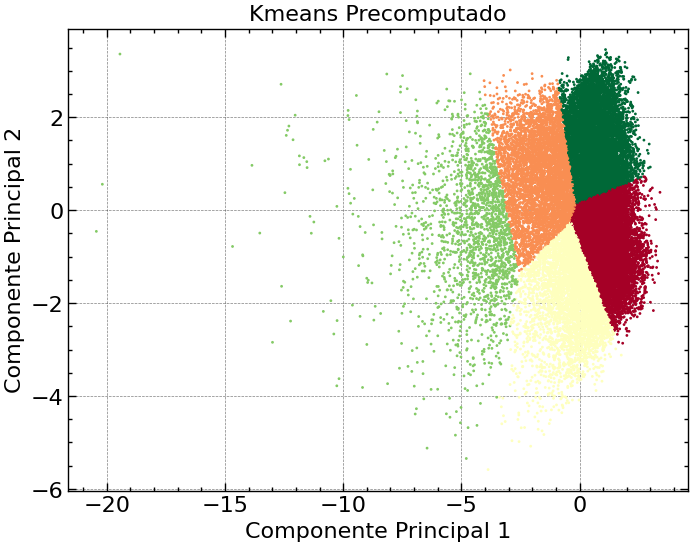

In [ ]:
pca = PCA(n_components=2)
pcaresult = pca.fit_transform(Xscaled)
kmeans = KMeans(n_clusters=5, random_state=42)
clusters = kmeans.fit_predict(pcaresult)
plt.scatter(pcaresult[:, 0], pcaresult[:, 1], c=clusters, cmap='RdYlGn', s=1)
plt.title('Kmeans Precomputado')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.show()

In [ ]:
# Add the cluster labels from K-Means on PCA to the original dataframe
data['KMeans_PCA_Cluster'] = clusters

# Group the original data by the 'KMeans_PCA_Cluster' column
for cluster_id in sorted(data['KMeans_PCA_Cluster'].unique()):
    print(f"Cluster {cluster_id} Description:")
    display(data[data['KMeans_PCA_Cluster'] == cluster_id].describe())
    print("\n" + "="*50 + "\n")

Cluster 0 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster,KMeans_PCA_Cluster
count,9993,9993.000000,9993.000000,9993.000000,9993.000000,9993.00000,9993.000000,9993.000000,9993.000000,9993.0
mean,2000-08-15 07:16:44.815370752,0.014770,0.010912,8.077413,8.015414,27.03620,0.017222,0.747523,0.344941,0.0
min,1900-01-25 06:22:00,0.000044,0.000000,0.650095,0.216022,22.37000,0.000553,0.000000,0.000000,0.0
25%,1984-12-19 18:05:00,0.007338,0.004809,6.177963,6.120770,26.04000,0.009342,0.000000,0.000000,0.0
50%,2017-03-18 04:49:00,0.014141,0.010497,8.143285,8.084815,26.93000,0.014604,1.000000,0.000000,0.0
75%,2022-04-23 13:06:00,0.020552,0.016420,9.984791,9.940386,27.90000,0.022002,1.000000,0.000000,0.0
max,2026-02-12 04:56:00,0.049983,0.031171,18.834843,18.831358,34.03700,0.119251,2.000000,4.000000,0.0
std,NaN,0.009454,0.006965,2.713856,2.733049,1.48825,0.011518,0.463003,0.879897,0.0




Cluster 1 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster,KMeans_PCA_Cluster
count,5117,5117.000000,5117.000000,5117.000000,5117.000000,5117.000000,5117.000000,5117.000000,5117.000000,5117.0
mean,1983-11-10 00:08:17.248387712,0.036779,0.035020,12.148976,12.141752,23.165701,0.105790,1.798710,2.549150,1.0
min,1900-01-04 22:25:00,0.009427,0.000930,2.712656,2.691730,18.750000,0.007490,0.000000,0.000000,1.0
25%,1949-12-03 02:03:00,0.030746,0.028938,9.081506,9.069489,22.210000,0.053023,2.000000,3.000000,1.0
50%,2001-07-02 06:57:00,0.037387,0.035636,12.159032,12.152569,23.370000,0.075242,2.000000,3.000000,1.0
75%,2018-09-07 13:55:00,0.043895,0.042544,14.713994,14.708496,24.130000,0.128369,2.000000,3.000000,1.0
max,2026-02-05 00:22:00,0.050000,0.049999,26.929582,26.926810,28.380000,0.631627,3.000000,4.000000,1.0
std,NaN,0.008484,0.009285,3.808592,3.811250,1.474150,0.086900,0.996541,0.989871,0.0




Cluster 2 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster,KMeans_PCA_Cluster
count,5008,5008.000000,5008.000000,5008.000000,5008.000000,5008.000000,5008.000000,5008.000000,5008.000000,5008.0
mean,2004-12-27 09:00:08.027156736,0.011544,0.009515,15.394484,15.341922,25.921696,0.032575,1.078275,1.574281,2.0
min,1900-02-27 07:57:00,0.000045,0.000000,6.237726,6.143385,20.050000,0.000814,0.000000,0.000000,2.0
25%,2006-04-14 23:09:00,0.004836,0.003691,12.629351,12.581492,24.750000,0.013504,1.000000,1.000000,2.0
50%,2018-09-30 17:48:30,0.010235,0.008276,14.628316,14.573218,25.940000,0.023039,1.000000,2.000000,2.0
75%,2022-10-28 14:22:30,0.016583,0.014354,17.613718,17.579649,27.100000,0.039853,1.000000,2.000000,2.0
max,2026-02-12 10:58:00,0.049614,0.033195,39.894881,39.883126,33.200000,0.347105,4.000000,3.000000,2.0
std,NaN,0.008417,0.006788,4.005188,4.011637,1.794914,0.031668,0.589726,0.816542,0.0




Cluster 3 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster,KMeans_PCA_Cluster
count,1906,1906.000000,1906.000000,1906.000000,1906.000000,1906.000000,1906.000000,1906.000000,1906.000000,1906.0
mean,1971-01-18 16:02:54.931794360,0.033765,0.033000,19.898679,19.893085,20.399289,0.422106,2.904512,2.944386,3.0
min,1900-02-05 23:42:00,0.000503,0.000499,5.505521,5.494498,14.080000,0.021700,0.000000,1.000000,3.0
25%,1936-09-16 18:21:00,0.025638,0.024639,15.782157,15.776840,19.220000,0.173165,3.000000,3.000000,3.0
50%,1975-04-12 08:38:30,0.035793,0.034819,19.383910,19.380496,20.461000,0.287251,3.000000,3.000000,3.0
75%,2008-04-05 03:05:30,0.043367,0.042761,23.633503,23.630095,21.560000,0.508699,3.000000,3.000000,3.0
max,2026-01-26 10:48:00,0.049991,0.049959,40.672808,40.670955,26.070000,5.425765,4.000000,3.000000,3.0
std,NaN,0.011270,0.011597,6.098271,6.099887,1.800056,0.447878,0.527770,0.242586,0.0




Cluster 4 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster,KMeans_PCA_Cluster
count,9302,9302.000000,9302.000000,9302.000000,9302.000000,9302.000000,9302.000000,9302.000000,9302.000000,9302.0
mean,1991-10-21 13:06:17.712320128,0.036490,0.032965,6.965339,6.952348,26.007809,0.025862,0.074608,3.436680,4.0
min,1900-01-11 01:07:00,0.016145,0.000136,0.275869,0.125474,22.320000,0.001015,0.000000,0.000000,4.0
25%,1966-05-26 17:41:45,0.030040,0.026662,4.926449,4.911795,25.110000,0.016086,0.000000,4.000000,4.0
50%,2009-10-17 06:53:30,0.036770,0.032817,6.858055,6.847994,25.880000,0.023684,0.000000,4.000000,4.0
75%,2020-11-15 18:03:15,0.043126,0.039984,8.854939,8.846693,26.720000,0.033765,0.000000,4.000000,4.0
max,2026-02-12 23:45:00,0.049996,0.049975,15.887748,15.883322,32.720000,0.122028,2.000000,4.000000,4.0
std,NaN,0.007915,0.009026,2.712620,2.719672,1.252640,0.013527,0.373890,1.187878,0.0


Pair plot for Cluster 0:


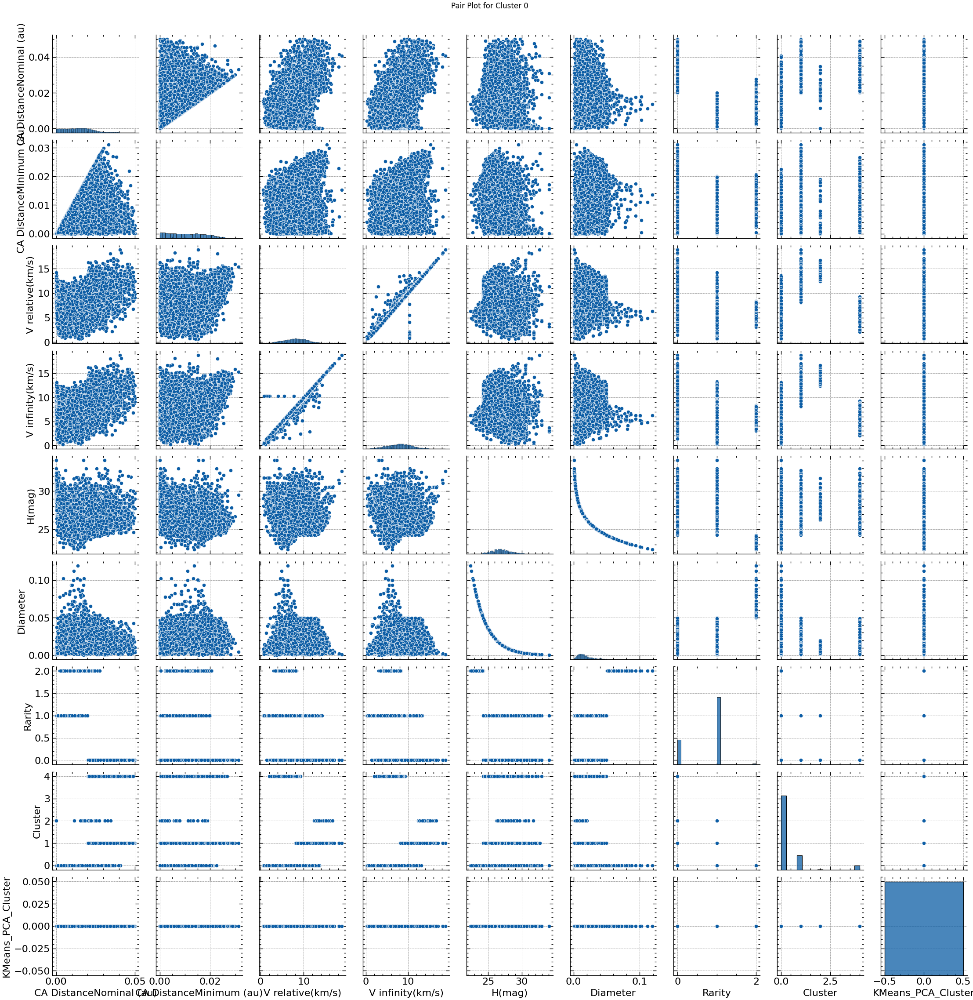



Pair plot for Cluster 1:


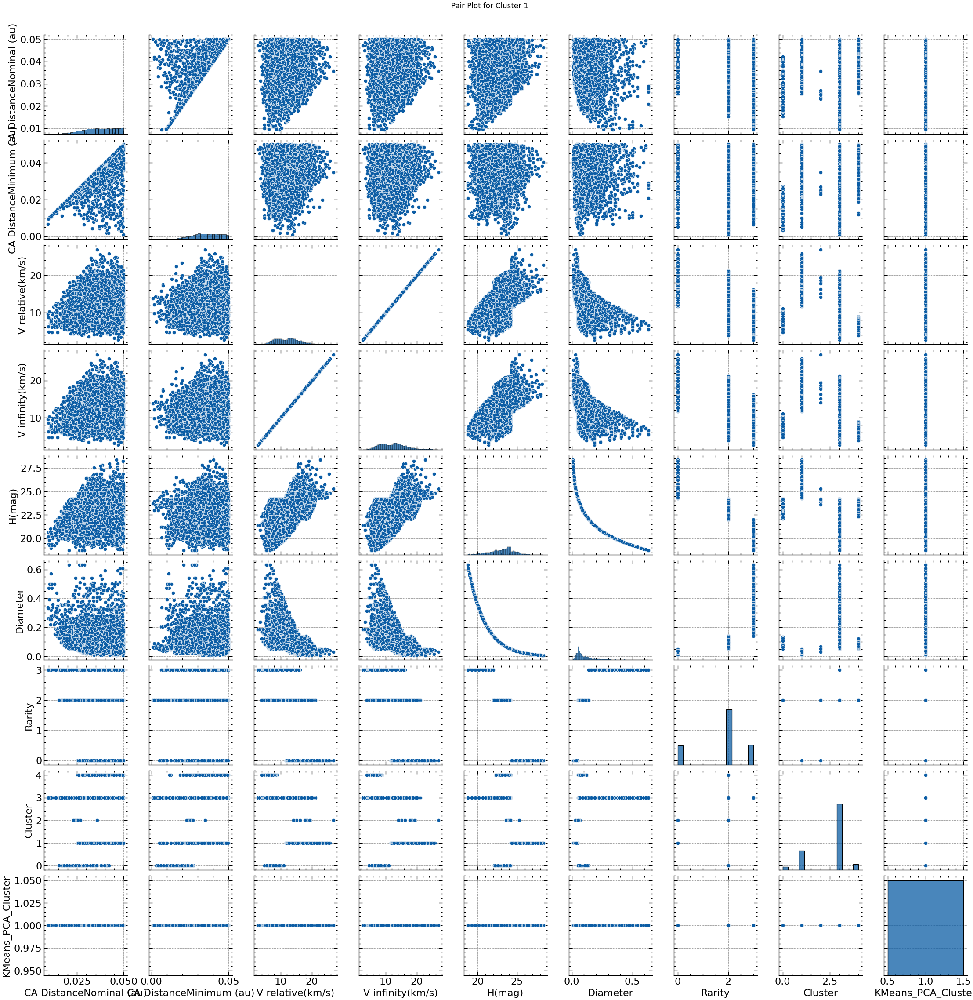



Pair plot for Cluster 2:


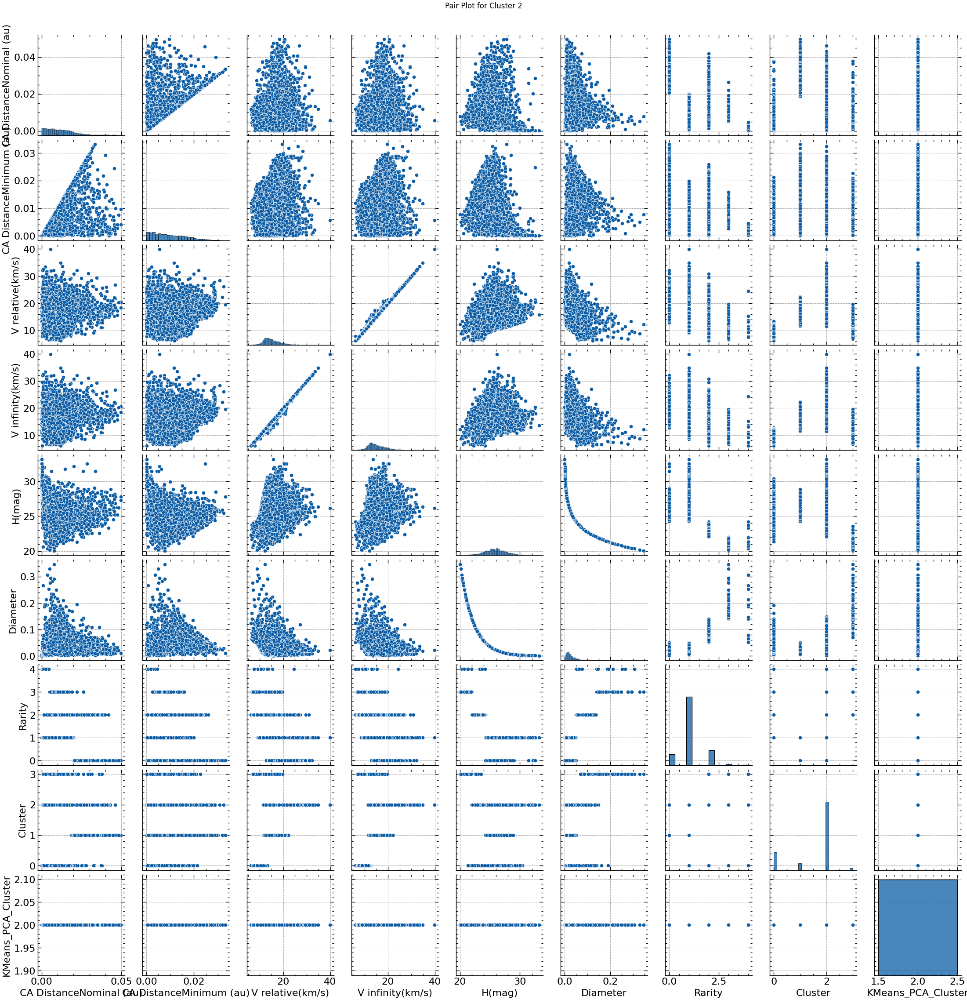



Pair plot for Cluster 3:


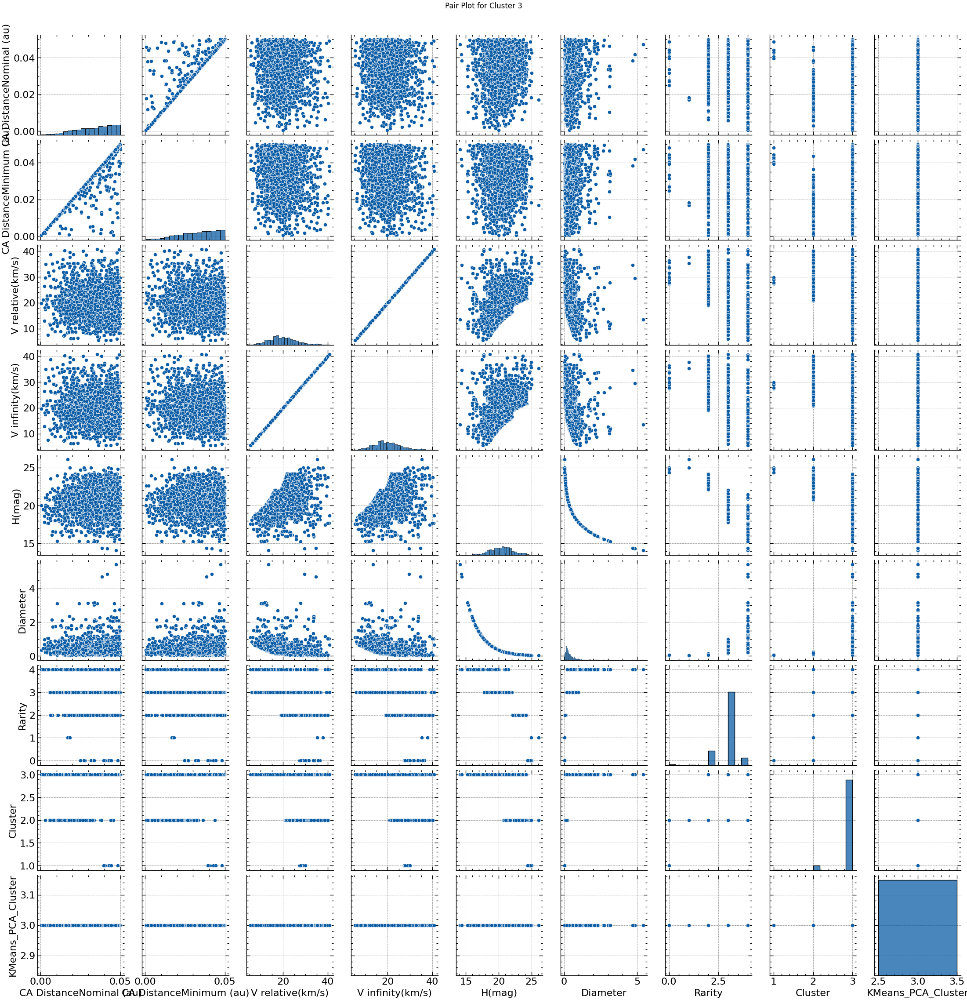



Pair plot for Cluster 4:


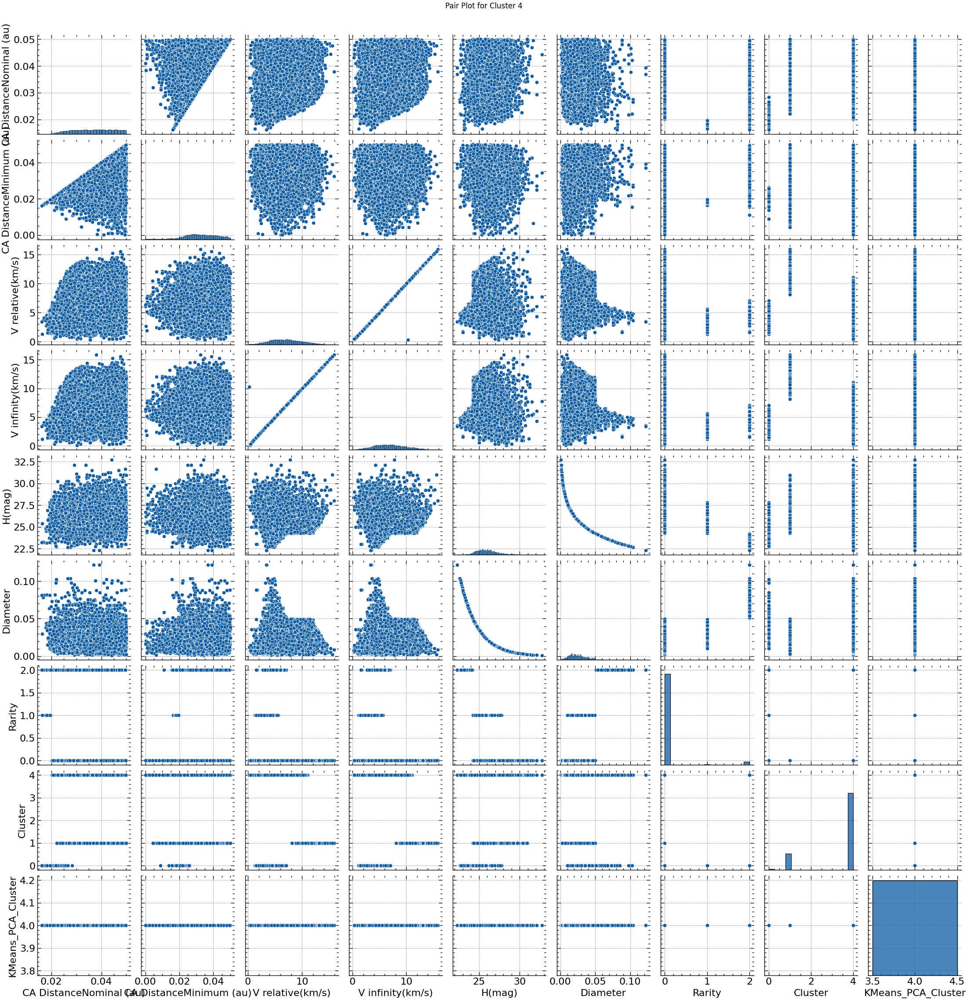

In [ ]:
for cluster_id in sorted(data['KMeans_PCA_Cluster'].unique()):
    print(f"Pair plot for Cluster {cluster_id}:")
    sns.pairplot(data=data[data['KMeans_PCA_Cluster'] == cluster_id].copy())
    plt.suptitle(f'Pair Plot for Cluster {cluster_id}', y=1.02)
    plt.show()
    print("\n" + "="*50 + "\n")

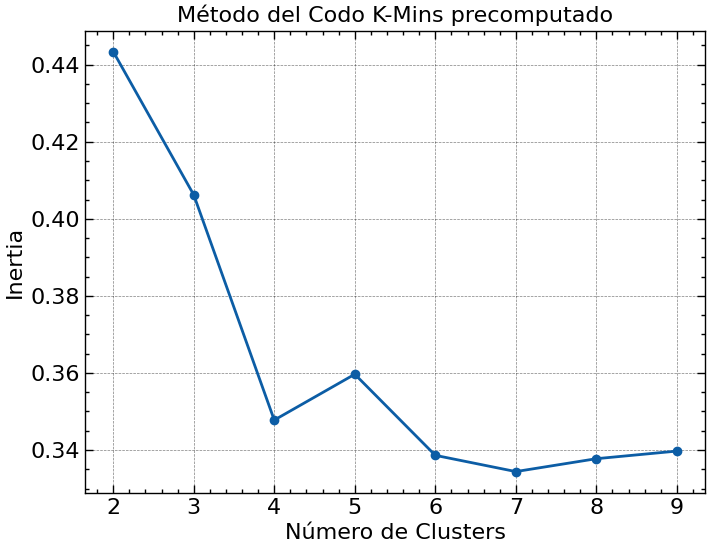

In [ ]:
pca = PCA(n_components=2)
pcaresult = pca.fit_transform(Xscaled)

inertia = []
valores_k = range(2, 10)
for k in valores_k:
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(pcaresult)
    score = silhouette_score(pcaresult, labels)
    inertia.append(score)

plt.plot(valores_k, inertia, marker='o')
plt.title('Método del Codo K-Mins precomputado')
plt.xlabel('Número de Clusters')
plt.ylabel('Inertia')
plt.show()

In [ ]:
inertia

[np.float64(0.44339178562887943),
 np.float64(0.4062074707900608),
 np.float64(0.34775872483699677),
 np.float64(0.35965926512003055),
 np.float64(0.33861204443033494),
 np.float64(0.33439521546819906),
 np.float64(0.33773958236733875),
 np.float64(0.3397153387861959)]

### **APLICAR PCA TENIENDO EN CUENTA RARITY**

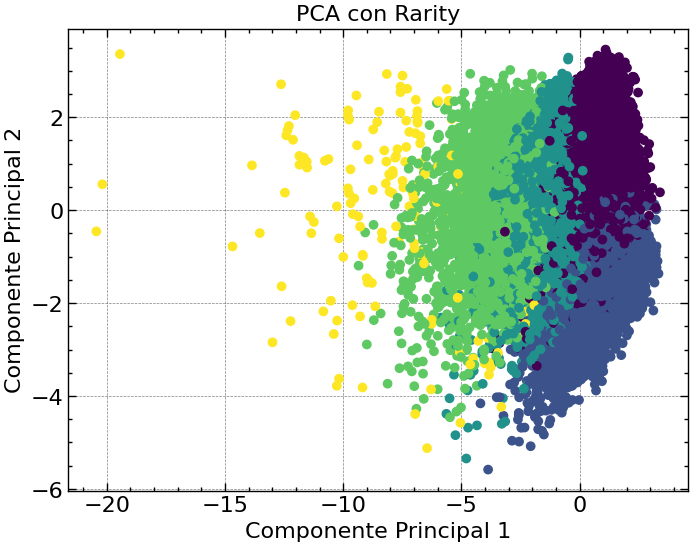

In [ ]:
pca = PCA(n_components=2)
pcaresult = pca.fit_transform(Xscaled)

plt.scatter(pcaresult[:, 0], pcaresult[:, 1], c=data['Rarity'])
plt.title('PCA con Rarity')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.show()

In [ ]:
# Group by the Rarity column and display descriptive statistics for each rarity level
for rarity_level in sorted(data['Rarity'].unique()):
    print(f"Rarity Level {rarity_level} Description:")
    display(data[data['Rarity'] == rarity_level].describe())
    print("\n" + "="*50 + "\n")

Rarity Level 0 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster,KMeans_PCA_Cluster
count,13227,13227.000000,13227.000000,13227.000000,13227.000000,13227.000000,13227.000000,13227.0,13227.000000,13227.000000
mean,1992-03-19 02:36:54.765252864,0.034402,0.029012,8.795436,8.783811,26.115850,0.024505,0.0,2.732819,2.871777
min,1900-01-11 01:07:00,0.020008,0.000000,0.275869,0.125474,24.260000,0.000553,0.0,0.000000,0.000000
25%,1966-12-11 11:06:30,0.026945,0.022023,5.801258,5.787355,25.180000,0.015505,0.0,1.000000,1.000000
50%,2010-10-08 13:08:00,0.034107,0.029310,8.122369,8.111846,25.900000,0.023467,0.0,4.000000,4.000000
75%,2021-01-22 18:22:00,0.041688,0.037840,11.090818,11.083450,26.800000,0.032693,0.0,4.000000,4.000000
max,2026-02-12 23:45:00,0.049996,0.049991,36.372328,36.370672,34.037000,0.049941,0.0,4.000000,4.000000
std,NaN,0.008603,0.011581,4.235174,4.240692,1.274736,0.011633,0.0,1.529927,1.680798




Rarity Level 1 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster,KMeans_PCA_Cluster
count,10823,10823.000000,10823.000000,10823.000000,10823.000000,10823.000000,10823.000000,10823.0,10823.000000,10823.000000
mean,2008-02-28 07:07:07.528411904,0.009733,0.008807,10.103698,10.027706,27.003074,0.017272,1.0,0.543934,0.673750
min,1900-02-04 06:16:00,0.000044,0.000000,0.650095,0.216022,24.260000,0.000553,1.0,0.000000,0.000000
25%,2009-03-13 08:31:30,0.004668,0.003710,6.766013,6.705262,26.000000,0.009342,1.0,0.000000,0.000000
50%,2019-07-30 03:01:00,0.009559,0.008234,9.300890,9.238895,26.900000,0.014807,1.0,0.000000,0.000000
75%,2023-01-01 18:11:00,0.014704,0.013635,12.706947,12.633526,27.900000,0.022411,1.0,2.000000,2.000000
max,2026-02-12 10:58:00,0.020000,0.019984,39.894881,39.883126,34.037000,0.049941,1.0,2.000000,4.000000
std,NaN,0.005780,0.005708,4.781583,4.791411,1.459456,0.010610,0.0,0.889208,0.959589




Rarity Level 2 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster,KMeans_PCA_Cluster
count,4505,4505.000000,4505.000000,4505.000000,4505.000000,4505.000000,4505.000000,4505.0,4505.000000,4505.000000
mean,1982-10-04 02:00:30.819089856,0.032138,0.030135,12.177820,12.166812,23.351026,0.079402,2.0,2.585350,1.489678
min,1900-02-04 03:50:00,0.001290,0.000043,1.581997,1.547734,22.030000,0.050172,2.0,0.000000,0.000000
25%,1948-09-02 08:48:00,0.023764,0.020724,8.398284,8.378277,22.820000,0.058947,2.0,2.000000,1.000000
50%,2000-07-26 05:32:00,0.033903,0.031673,11.218535,11.208795,23.470000,0.071856,2.0,3.000000,1.000000
75%,2017-10-18 06:12:00,0.042052,0.040693,14.977864,14.972229,23.900000,0.096931,2.0,3.000000,2.000000
max,2026-02-05 22:49:00,0.050000,0.049997,40.190937,40.186533,24.250000,0.139464,2.0,4.000000,4.000000
std,NaN,0.011956,0.012645,5.318961,5.323137,0.641588,0.024719,0.0,1.169991,0.934081




Rarity Level 3 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster,KMeans_PCA_Cluster
count,2613,2613.000000,2613.000000,2613.000000,2613.000000,2613.000000,2613.000000,2613.0,2613.000000,2613.000000
mean,1967-04-19 04:06:19.655568368,0.033594,0.032988,15.079875,15.072134,20.544845,0.316035,3.0,2.988136,2.146958
min,1900-01-04 22:25:00,0.005019,0.000802,2.712656,2.691730,17.760000,0.140107,3.0,0.000000,1.000000
25%,1934-02-09 08:11:00,0.025546,0.024722,10.118111,10.110796,19.820000,0.182163,3.0,3.000000,1.000000
50%,1968-03-14 19:39:00,0.035500,0.034807,14.029441,14.023221,20.750000,0.251455,3.0,3.000000,3.000000
75%,2002-01-26 15:43:00,0.043374,0.042916,18.889850,18.886931,21.450000,0.385888,3.0,3.000000,3.000000
max,2025-12-15 21:29:00,0.049999,0.049999,40.672808,40.670955,22.020000,0.996463,3.0,3.000000,3.000000
std,NaN,0.011346,0.011655,6.428559,6.431705,1.077818,0.182349,0.0,0.152358,0.974320




Rarity Level 4 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster,KMeans_PCA_Cluster
count,158,158.000000,158.000000,158.000000,158.000000,158.000000,158.000000,158.0,158.000000,158.000000
mean,1968-05-02 12:54:15.189873312,0.028169,0.027917,17.364521,17.331523,17.496772,1.437335,4.0,2.949367,2.917722
min,1901-04-26 12:50:00,0.000228,0.000228,5.505521,5.494498,14.080000,0.051578,4.0,0.000000,2.000000
25%,1941-02-08 06:56:45,0.015533,0.013947,11.711169,11.700056,16.475000,1.029108,4.0,3.000000,3.000000
50%,1968-01-13 01:44:00,0.032772,0.032002,16.935262,16.930144,17.270000,1.248708,4.0,3.000000,3.000000
75%,2000-05-03 17:20:30,0.042374,0.042037,21.088754,21.065005,17.690000,1.800796,4.0,3.000000,3.000000
max,2024-06-29 13:49:00,0.049959,0.049959,40.509275,40.507937,24.190000,5.425765,4.0,3.000000,3.000000
std,NaN,0.016198,0.016182,7.749057,7.770167,1.797864,0.876430,0.0,0.353282,0.275662


Pair plot for Rarity Level 0:


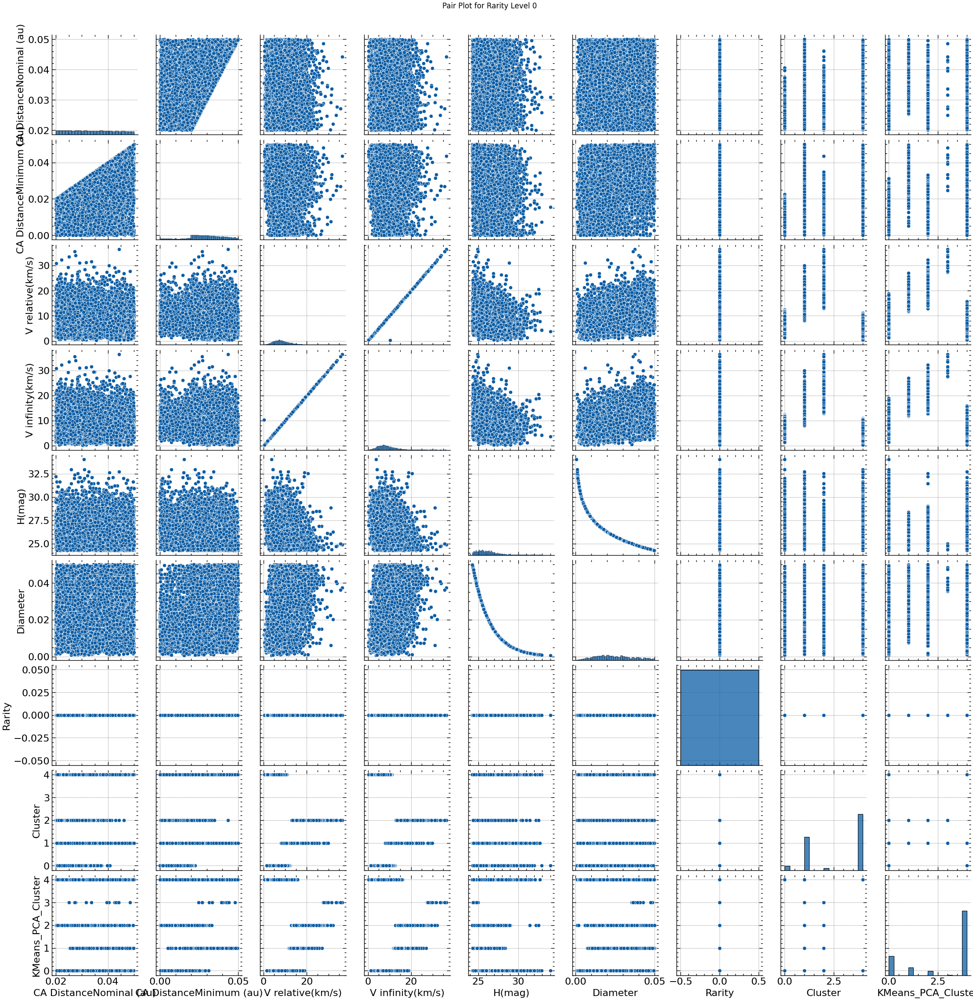



Pair plot for Rarity Level 1:


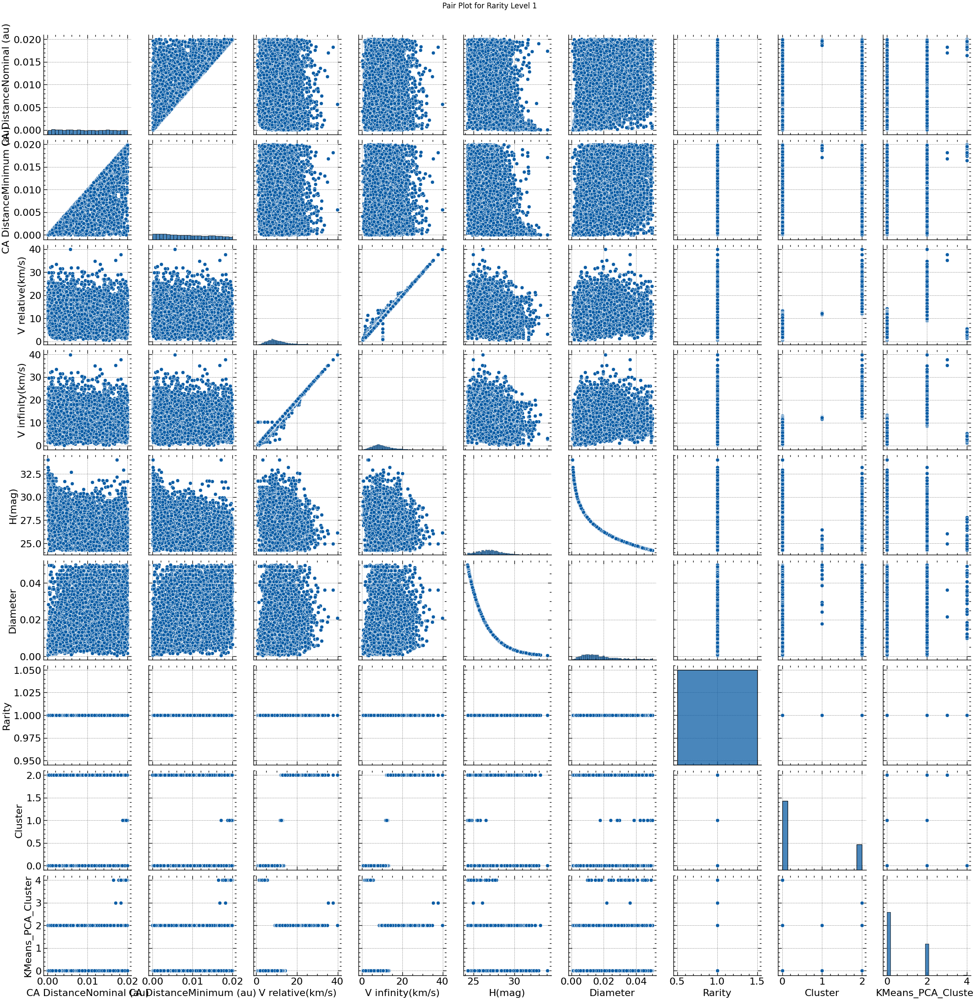



Pair plot for Rarity Level 2:


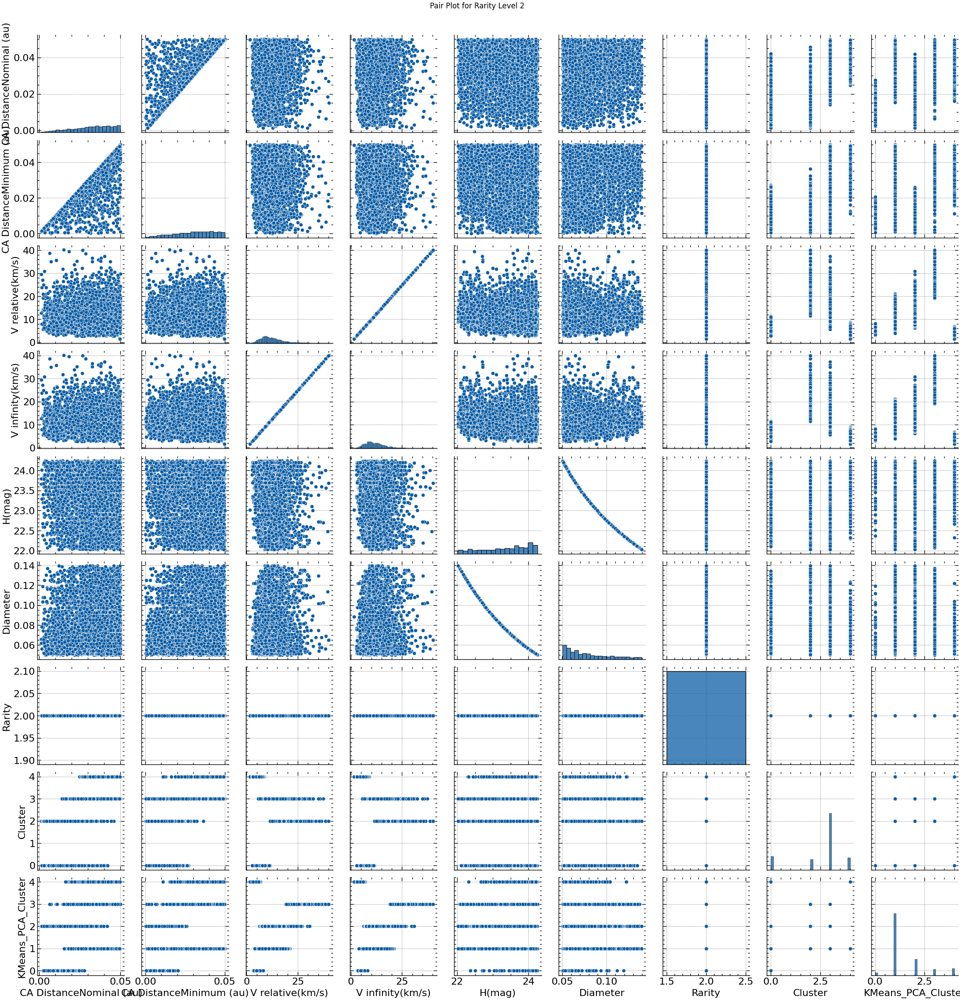



Pair plot for Rarity Level 3:


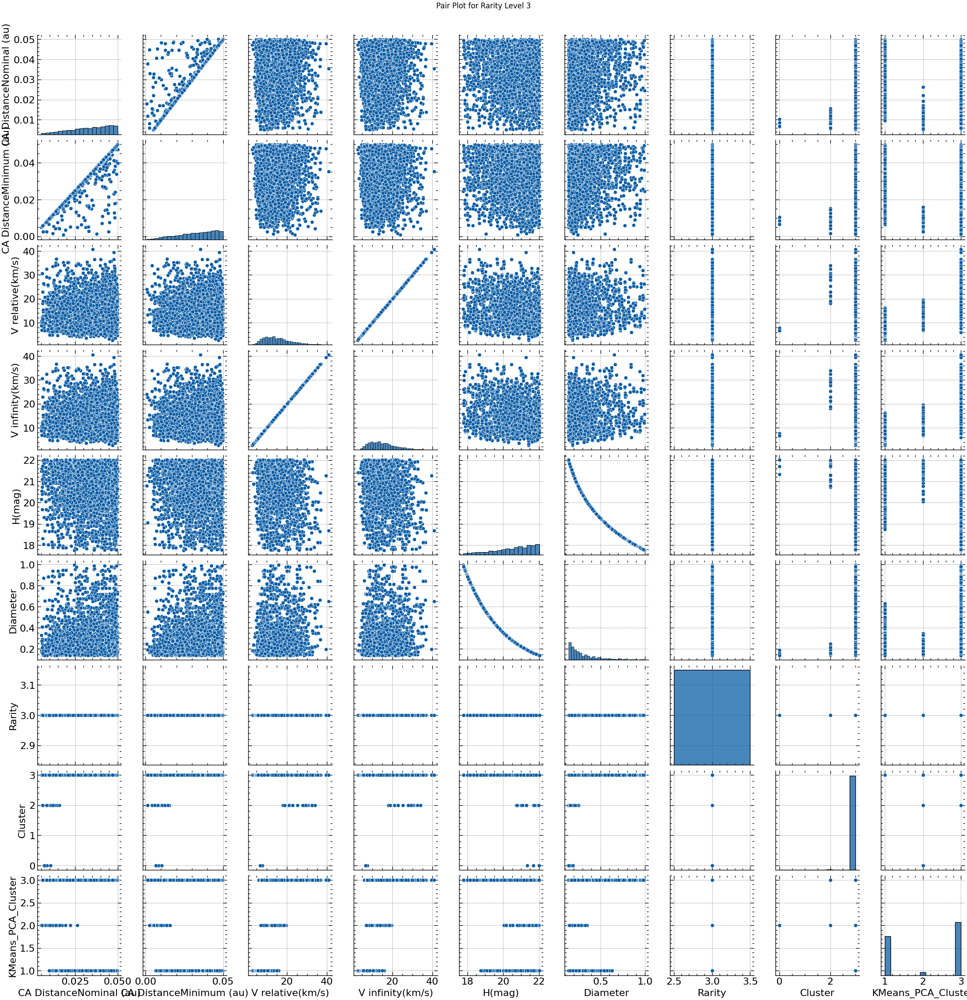



Pair plot for Rarity Level 4:


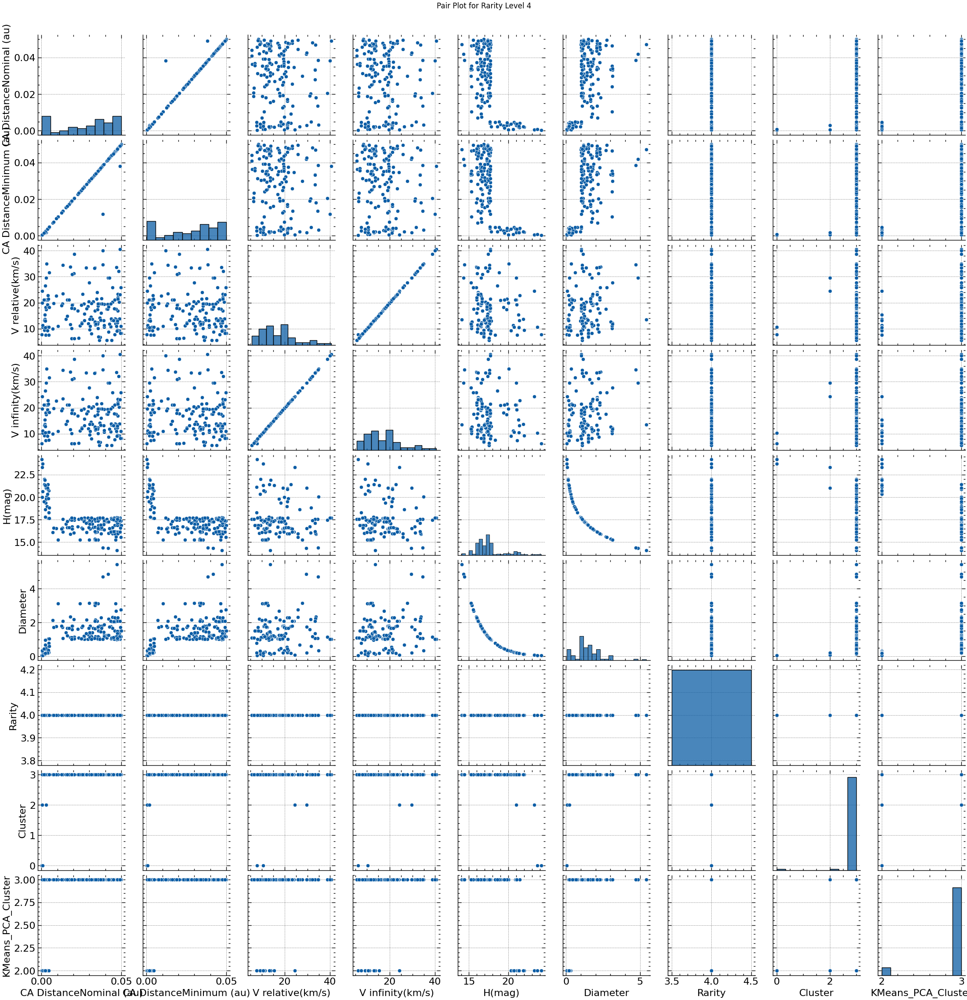

In [ ]:
for rarity_level in sorted(data['Rarity'].unique()):
    print(f"Pair plot for Rarity Level {rarity_level}:")
    sns.pairplot(data=data[data['Rarity'] == rarity_level].copy())
    plt.suptitle(f'Pair Plot for Rarity Level {rarity_level}', y=1.02)
    plt.show()
    print("\n" + "="*50 + "\n")

### **APLICANDO T-SNE**

In [ ]:
# tsne = TSNE(n_components=2, perplexity=50, random_state=42)
# X_tsne = tsne.fit_transform(Xscaled)

# plt.figure(figsize=(6, 5))
# plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=labels, cmap='tab10', s=1)
# plt.title('t-SNE')
# plt.xlabel('Componente 1')
# plt.ylabel('Componente 2')
# plt.colorbar(label='Cluster')
# plt.show()

In [ ]:
!pip install openTSNE

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.5/3.5 MB 8.0 MB/s eta 0:00:00


Varianza explicada acumulada PCA : 72.73%
[t-SNE] Computing 76 nearest neighbors...
[t-SNE] Indexed 31326 samples in 0.042s...


[t-SNE] Computed neighbors for 31326 samples in 1.102s...
[t-SNE] Computed conditional probabilities for sample 1000 / 31326
[t-SNE] Computed conditional probabilities for sample 2000 / 31326
[t-SNE] Computed conditional probabilities for sample 3000 / 31326
[t-SNE] Computed conditional probabilities for sample 4000 / 31326
[t-SNE] Computed conditional probabilities for sample 5000 / 31326
[t-SNE] Computed conditional probabilities for sample 6000 / 31326
[t-SNE] Computed conditional probabilities for sample 7000 / 31326
[t-SNE] Computed conditional probabilities for sample 8000 / 31326
[t-SNE] Computed conditional probabilities for sample 9000 / 31326
[t-SNE] Computed conditional probabilities for sample 10000 / 31326
[t-SNE] Computed conditional probabilities for sample 11000 / 31326
[t-SNE] Computed conditional probabilities for sample 12000 / 31326
[t-SNE] Computed conditional probabilities for sample 13000 / 31326
[t-SNE] Computed conditional probabilities for sample 14000 / 31326

[t-SNE] Computed neighbors for 31326 samples in 0.452s...
[t-SNE] Computed conditional probabilities for sample 1000 / 31326
[t-SNE] Computed conditional probabilities for sample 2000 / 31326
[t-SNE] Computed conditional probabilities for sample 3000 / 31326
[t-SNE] Computed conditional probabilities for sample 4000 / 31326
[t-SNE] Computed conditional probabilities for sample 5000 / 31326
[t-SNE] Computed conditional probabilities for sample 6000 / 31326
[t-SNE] Computed conditional probabilities for sample 7000 / 31326
[t-SNE] Computed conditional probabilities for sample 8000 / 31326
[t-SNE] Computed conditional probabilities for sample 9000 / 31326
[t-SNE] Computed conditional probabilities for sample 10000 / 31326
[t-SNE] Computed conditional probabilities for sample 11000 / 31326
[t-SNE] Computed conditional probabilities for sample 12000 / 31326
[t-SNE] Computed conditional probabilities for sample 13000 / 31326
[t-SNE] Computed conditional probabilities for sample 14000 / 31326

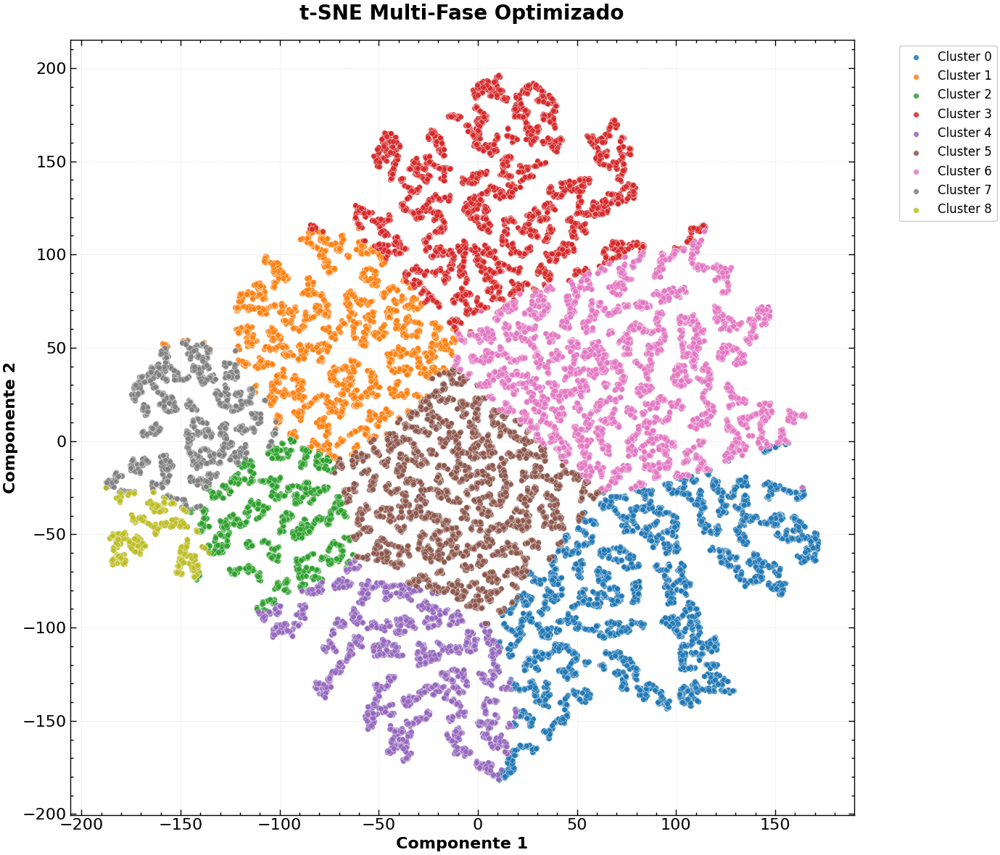

UMAP Trustworthiness (15 vecinos): 0.7927
UMAP Continuity (15 vecinos): 0.7927


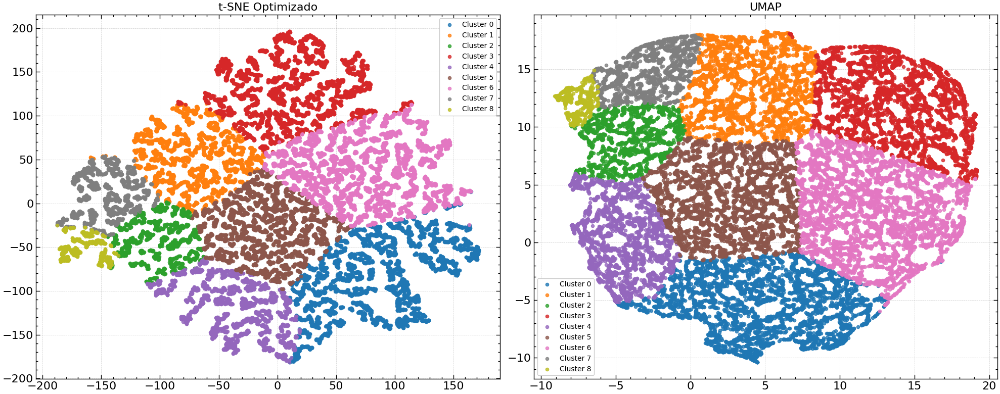

In [ ]:
 # Código completo para análisis avanzado y visualización optimizada con t-SNE y UMAP

 from sklearn.decomposition import PCA
 from sklearn.manifold import TSNE
 from sklearn.metrics import pairwise_distances
 from sklearn.neighbors import NearestNeighbors
 from sklearn.preprocessing import StandardScaler

 import umap

# --- Funciones para métricas de calidad t-SNE ---

def trustworthiness(X_high, X_low, n_neighbors=10):
    """
    Trustworthiness mide qué tan bien la estructura local del espacio original
    se preserva en el embedding de baja dimensión.
    """
    n_samples = X_high.shape[0]
    nbrs_high = NearestNeighbors(n_neighbors=n_neighbors).fit(X_high)
    high_dist, high_idx = nbrs_high.kneighbors(X_high)

    nbrs_low = NearestNeighbors(n_neighbors=n_neighbors).fit(X_low)
    low_dist, low_idx = nbrs_low.kneighbors(X_low)

    trust_sum = 0.0
    for i in range(n_samples):
        set_high = set(high_idx[i, 1:])  # vecinos en espacio original (excluye punto mismo)
        set_low = set(low_idx[i, 1:])    # vecinos en embedding
        # vecinos en embedding que no están en original (intrusos)
        intruders = set_low - set_high
        for u in intruders:
            rank = np.where(high_idx[i] == u)[0]
            if len(rank) > 0:
                rank = rank[0]
                trust_sum += rank - n_neighbors
            else:
                trust_sum += n_samples
    trust = 1 - (2 / (n_samples * n_neighbors * (2 * n_samples - 3 * n_neighbors - 1))) * trust_sum
    return trust

def continuity(X_high, X_low, n_neighbors=10):
    """
    Continuity mide qué tan bien los vecinos en el embedding corresponden a vecinos en el espacio original.
    """
    n_samples = X_high.shape[0]
    nbrs_high = NearestNeighbors(n_neighbors=n_neighbors).fit(X_high)
    high_dist, high_idx = nbrs_high.kneighbors(X_high)

    nbrs_low = NearestNeighbors(n_neighbors=n_neighbors).fit(X_low)
    low_dist, low_idx = nbrs_low.kneighbors(X_low)

    cont_sum = 0.0
    for i in range(n_samples):
        set_high = set(high_idx[i, 1:])
        set_low = set(low_idx[i, 1:])
        misses = set_high - set_low
        for m in misses:
            rank = np.where(low_idx[i] == m)[0]
            if len(rank) > 0:
                rank = rank[0]
                cont_sum += rank - n_neighbors
            else:
                cont_sum += n_samples
    cont = 1 - (2 / (n_samples * n_neighbors * (2 * n_samples - 3 * n_neighbors - 1))) * cont_sum
    return cont

# --- Preprocesamiento ---

# Escalado estándar
scaler = StandardScaler()
Xscaled = scaler.fit_transform(X)

# PCA previo para reducir ruido y dimensionalidad
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(Xscaled)

print(f"Varianza explicada acumulada PCA : {np.sum(pca.explained_variance_ratio_):.2%}")

# --- t-SNE en dos fases (simulación late exaggeration) ---

tsne_phase1 = TSNE(
    n_components=2,
    perplexity=25,
    early_exaggeration=40,
    learning_rate=1000,
    n_iter=1000,
    random_state=42,
    init='pca',
    verbose=1
)
X_tsne_phase1 = tsne_phase1.fit_transform(X_pca)

tsne_phase2 = TSNE(
    n_components=2,
    perplexity=20,
    early_exaggeration=25,
    learning_rate=500,
    n_iter=1500,
    random_state=42,
    init=X_tsne_phase1,
    verbose=1
)
X_tsne_refined = tsne_phase2.fit_transform(X_pca)

# --- Cálculo métricas de calidad ---

trust = trustworthiness(X_pca, X_tsne_refined, n_neighbors=15)
cont = continuity(X_pca, X_tsne_refined, n_neighbors=15)

print(f"Trustworthiness (15 vecinos): {trust:.4f}")
print(f"Continuity (15 vecinos): {cont:.4f}")

# --- Visualización t-SNE optimizado ---

plt.figure(figsize=(14, 12))
palette = sns.color_palette("tab10", n_colors=len(np.unique(labels)))

for i, cluster in enumerate(np.unique(labels)):
    mask = labels == cluster
    plt.scatter(
        X_tsne_refined[mask, 0], X_tsne_refined[mask, 1],
        c=[palette[i]],
        label=f'Cluster {cluster}',
        s=30,
        alpha=0.85,
        edgecolors='white',
        linewidth=0.3
    )
plt.title('t-SNE Multi-Fase Optimizado', fontsize=20, fontweight='bold', pad=20)
plt.xlabel('Componente 1', fontsize=16, fontweight='bold')
plt.ylabel('Componente 2', fontsize=16, fontweight='bold')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)
plt.grid(True, alpha=0.1)
plt.tight_layout()
plt.show()

# --- Aplicación y visualización con UMAP para comparación ---

umap_reducer = umap.UMAP(
    n_neighbors=15,
    min_dist=0.1,
    n_components=2,
    metric='euclidean',
    random_state=42
)
X_umap = umap_reducer.fit_transform(X_pca)

# Métricas UMAP
trust_umap = trustworthiness(X_pca, X_umap, n_neighbors=15)
cont_umap = continuity(X_pca, X_umap, n_neighbors=15)

print(f"UMAP Trustworthiness (15 vecinos): {trust_umap:.4f}")
print(f"UMAP Continuity (15 vecinos): {cont_umap:.4f}")

# Visualización comparativa lado a lado
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

for i, cluster in enumerate(np.unique(labels)):
    mask = labels == cluster
    ax1.scatter(
        X_tsne_refined[mask, 0], X_tsne_refined[mask, 1],
        c=[palette[i]], s=20, alpha=0.8, label=f'Cluster {cluster}'
    )
ax1.set_title('t-SNE Optimizado')
ax1.grid(True, alpha=0.2)
ax1.legend(fontsize=10)

for i, cluster in enumerate(np.unique(labels)):
    mask = labels == cluster
    ax2.scatter(
        X_umap[mask, 0], X_umap[mask, 1],
        c=[palette[i]], s=20, alpha=0.8, label=f'Cluster {cluster}'
    )
ax2.set_title('UMAP')
ax2.grid(True, alpha=0.2)
ax2.legend(fontsize=10)

plt.tight_layout()
plt.show()

In [ ]:
# Add the cluster labels to the original dataframe
data['tSNE_Cluster'] = clusters

# Group by the t-SNE cluster and display descriptive statistics for each cluster
for cluster_id in sorted(data['tSNE_Cluster'].unique()):
    print(f"Cluster {cluster_id} Description:")
    display(data[data['tSNE_Cluster'] == cluster_id].describe())
    print("\n" + "="*50 + "\n")

Cluster 0 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster,KMeans_PCA_Cluster,tSNE_Cluster
count,9993,9993.000000,9993.000000,9993.000000,9993.000000,9993.00000,9993.000000,9993.000000,9993.000000,9993.0,9993.0
mean,2000-08-15 07:16:44.815370752,0.014770,0.010912,8.077413,8.015414,27.03620,0.017222,0.747523,0.344941,0.0,0.0
min,1900-01-25 06:22:00,0.000044,0.000000,0.650095,0.216022,22.37000,0.000553,0.000000,0.000000,0.0,0.0
25%,1984-12-19 18:05:00,0.007338,0.004809,6.177963,6.120770,26.04000,0.009342,0.000000,0.000000,0.0,0.0
50%,2017-03-18 04:49:00,0.014141,0.010497,8.143285,8.084815,26.93000,0.014604,1.000000,0.000000,0.0,0.0
75%,2022-04-23 13:06:00,0.020552,0.016420,9.984791,9.940386,27.90000,0.022002,1.000000,0.000000,0.0,0.0
max,2026-02-12 04:56:00,0.049983,0.031171,18.834843,18.831358,34.03700,0.119251,2.000000,4.000000,0.0,0.0
std,NaN,0.009454,0.006965,2.713856,2.733049,1.48825,0.011518,0.463003,0.879897,0.0,0.0




Cluster 1 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster,KMeans_PCA_Cluster,tSNE_Cluster
count,5117,5117.000000,5117.000000,5117.000000,5117.000000,5117.000000,5117.000000,5117.000000,5117.000000,5117.0,5117.0
mean,1983-11-10 00:08:17.248387712,0.036779,0.035020,12.148976,12.141752,23.165701,0.105790,1.798710,2.549150,1.0,1.0
min,1900-01-04 22:25:00,0.009427,0.000930,2.712656,2.691730,18.750000,0.007490,0.000000,0.000000,1.0,1.0
25%,1949-12-03 02:03:00,0.030746,0.028938,9.081506,9.069489,22.210000,0.053023,2.000000,3.000000,1.0,1.0
50%,2001-07-02 06:57:00,0.037387,0.035636,12.159032,12.152569,23.370000,0.075242,2.000000,3.000000,1.0,1.0
75%,2018-09-07 13:55:00,0.043895,0.042544,14.713994,14.708496,24.130000,0.128369,2.000000,3.000000,1.0,1.0
max,2026-02-05 00:22:00,0.050000,0.049999,26.929582,26.926810,28.380000,0.631627,3.000000,4.000000,1.0,1.0
std,NaN,0.008484,0.009285,3.808592,3.811250,1.474150,0.086900,0.996541,0.989871,0.0,0.0




Cluster 2 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster,KMeans_PCA_Cluster,tSNE_Cluster
count,5008,5008.000000,5008.000000,5008.000000,5008.000000,5008.000000,5008.000000,5008.000000,5008.000000,5008.0,5008.0
mean,2004-12-27 09:00:08.027156736,0.011544,0.009515,15.394484,15.341922,25.921696,0.032575,1.078275,1.574281,2.0,2.0
min,1900-02-27 07:57:00,0.000045,0.000000,6.237726,6.143385,20.050000,0.000814,0.000000,0.000000,2.0,2.0
25%,2006-04-14 23:09:00,0.004836,0.003691,12.629351,12.581492,24.750000,0.013504,1.000000,1.000000,2.0,2.0
50%,2018-09-30 17:48:30,0.010235,0.008276,14.628316,14.573218,25.940000,0.023039,1.000000,2.000000,2.0,2.0
75%,2022-10-28 14:22:30,0.016583,0.014354,17.613718,17.579649,27.100000,0.039853,1.000000,2.000000,2.0,2.0
max,2026-02-12 10:58:00,0.049614,0.033195,39.894881,39.883126,33.200000,0.347105,4.000000,3.000000,2.0,2.0
std,NaN,0.008417,0.006788,4.005188,4.011637,1.794914,0.031668,0.589726,0.816542,0.0,0.0




Cluster 3 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster,KMeans_PCA_Cluster,tSNE_Cluster
count,1906,1906.000000,1906.000000,1906.000000,1906.000000,1906.000000,1906.000000,1906.000000,1906.000000,1906.0,1906.0
mean,1971-01-18 16:02:54.931794360,0.033765,0.033000,19.898679,19.893085,20.399289,0.422106,2.904512,2.944386,3.0,3.0
min,1900-02-05 23:42:00,0.000503,0.000499,5.505521,5.494498,14.080000,0.021700,0.000000,1.000000,3.0,3.0
25%,1936-09-16 18:21:00,0.025638,0.024639,15.782157,15.776840,19.220000,0.173165,3.000000,3.000000,3.0,3.0
50%,1975-04-12 08:38:30,0.035793,0.034819,19.383910,19.380496,20.461000,0.287251,3.000000,3.000000,3.0,3.0
75%,2008-04-05 03:05:30,0.043367,0.042761,23.633503,23.630095,21.560000,0.508699,3.000000,3.000000,3.0,3.0
max,2026-01-26 10:48:00,0.049991,0.049959,40.672808,40.670955,26.070000,5.425765,4.000000,3.000000,3.0,3.0
std,NaN,0.011270,0.011597,6.098271,6.099887,1.800056,0.447878,0.527770,0.242586,0.0,0.0




Cluster 4 Description:


,Close-Approach (CA) Date,CA DistanceNominal (au),CA DistanceMinimum (au),V relative(km/s),V infinity(km/s),H(mag),Diameter,Rarity,Cluster,KMeans_PCA_Cluster,tSNE_Cluster
count,9302,9302.000000,9302.000000,9302.000000,9302.000000,9302.000000,9302.000000,9302.000000,9302.000000,9302.0,9302.0
mean,1991-10-21 13:06:17.712320128,0.036490,0.032965,6.965339,6.952348,26.007809,0.025862,0.074608,3.436680,4.0,4.0
min,1900-01-11 01:07:00,0.016145,0.000136,0.275869,0.125474,22.320000,0.001015,0.000000,0.000000,4.0,4.0
25%,1966-05-26 17:41:45,0.030040,0.026662,4.926449,4.911795,25.110000,0.016086,0.000000,4.000000,4.0,4.0
50%,2009-10-17 06:53:30,0.036770,0.032817,6.858055,6.847994,25.880000,0.023684,0.000000,4.000000,4.0,4.0
75%,2020-11-15 18:03:15,0.043126,0.039984,8.854939,8.846693,26.720000,0.033765,0.000000,4.000000,4.0,4.0
max,2026-02-12 23:45:00,0.049996,0.049975,15.887748,15.883322,32.720000,0.122028,2.000000,4.000000,4.0,4.0
std,NaN,0.007915,0.009026,2.712620,2.719672,1.252640,0.013527,0.373890,1.187878,0.0,0.0


Pair plot for tSNE Cluster 0:


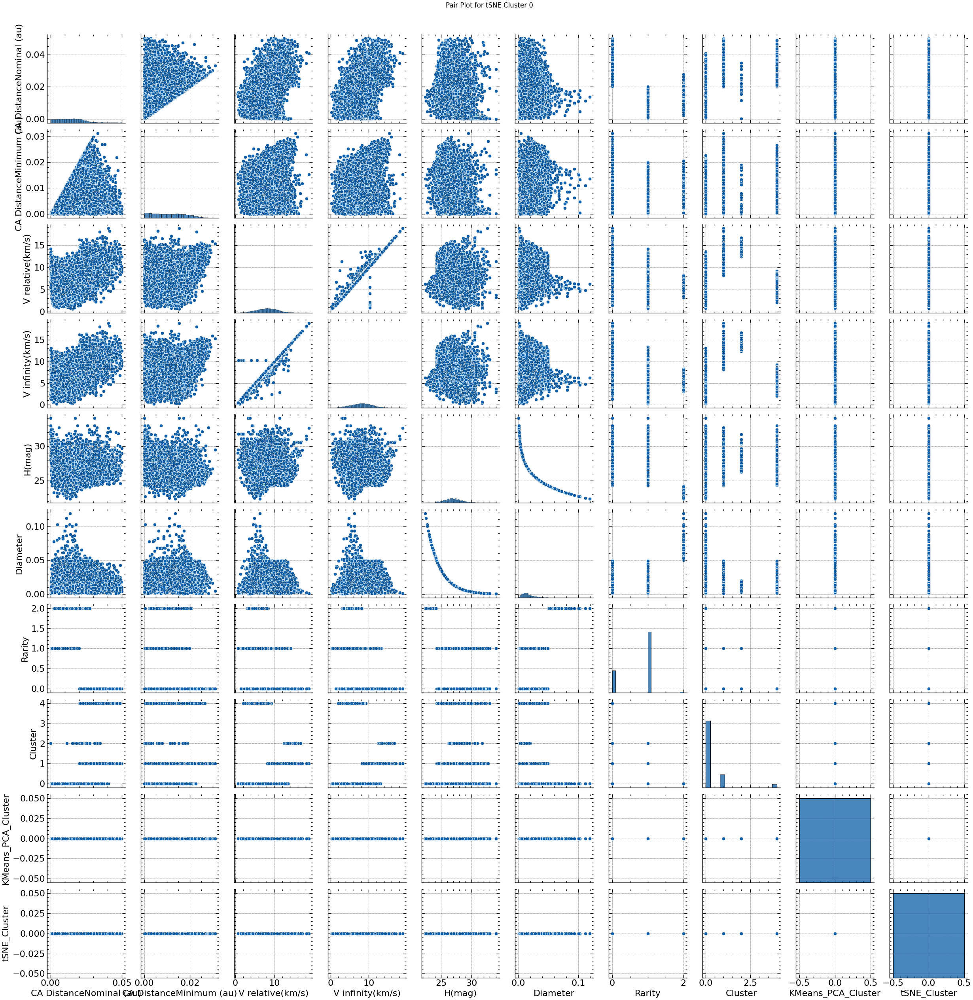



Pair plot for tSNE Cluster 1:


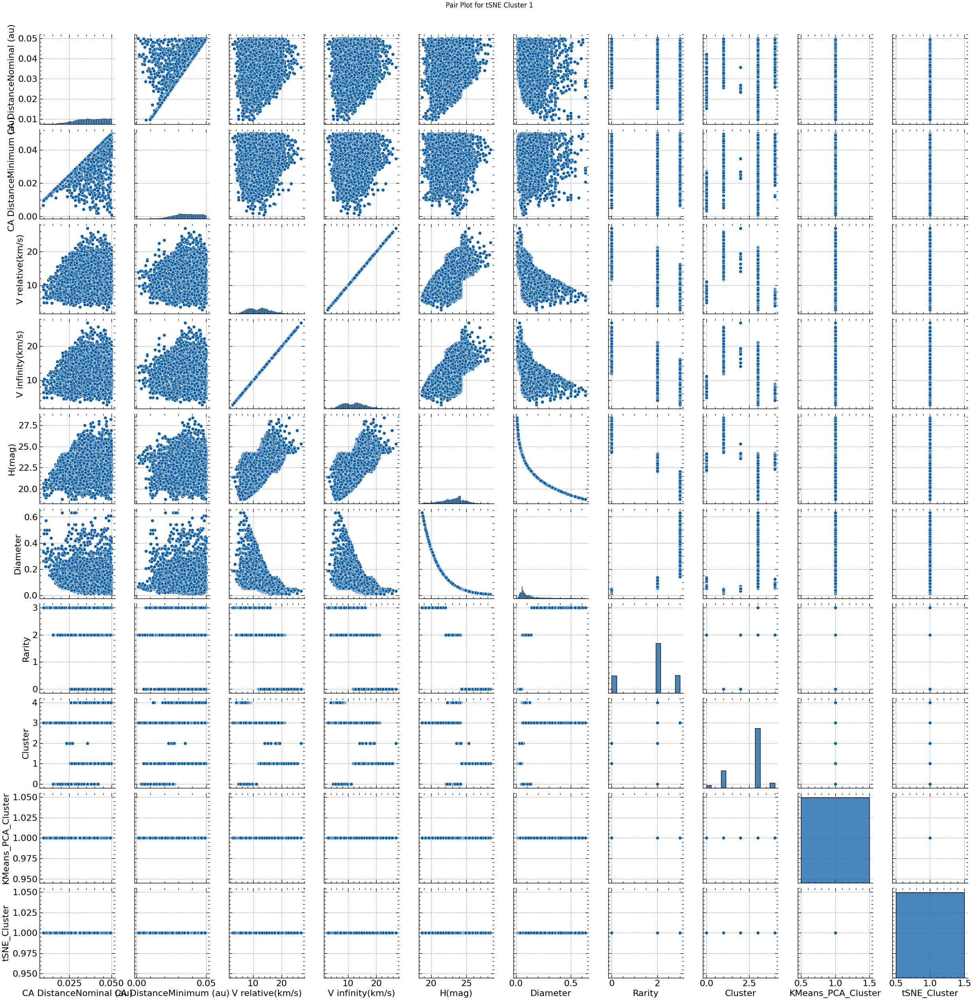



Pair plot for tSNE Cluster 2:


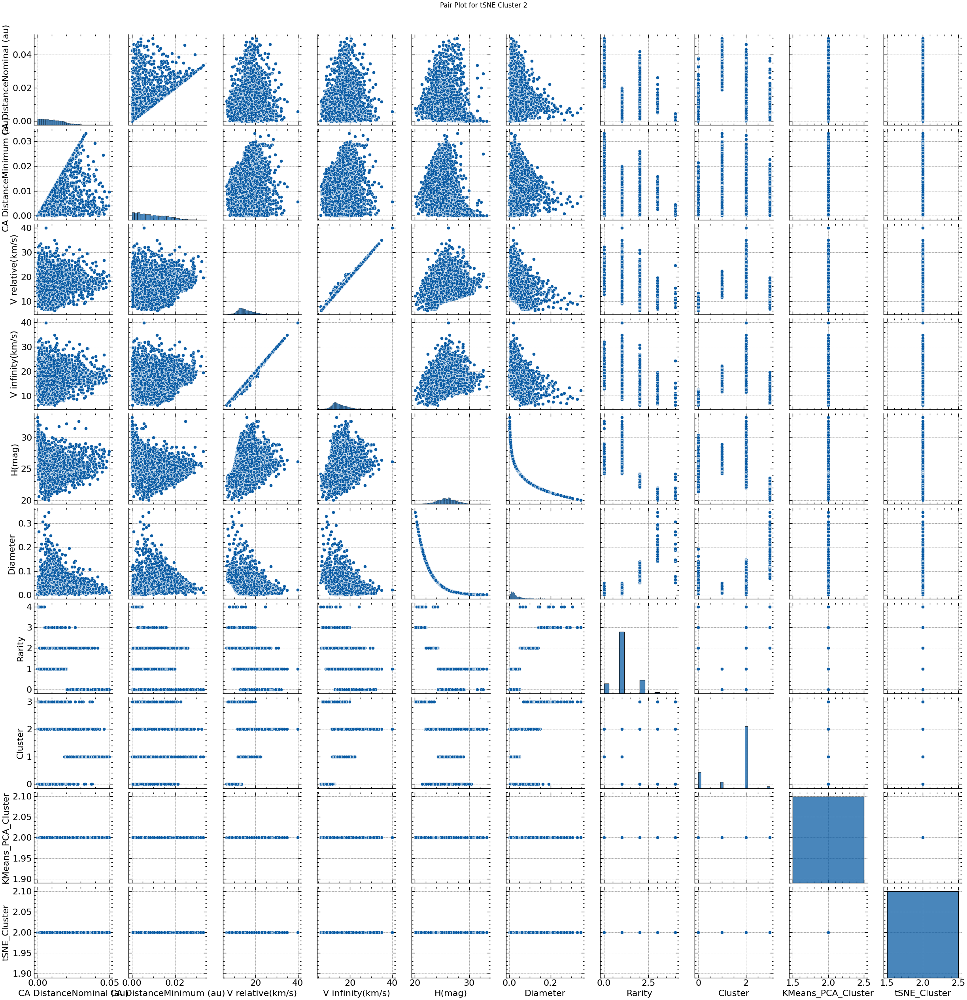



Pair plot for tSNE Cluster 3:


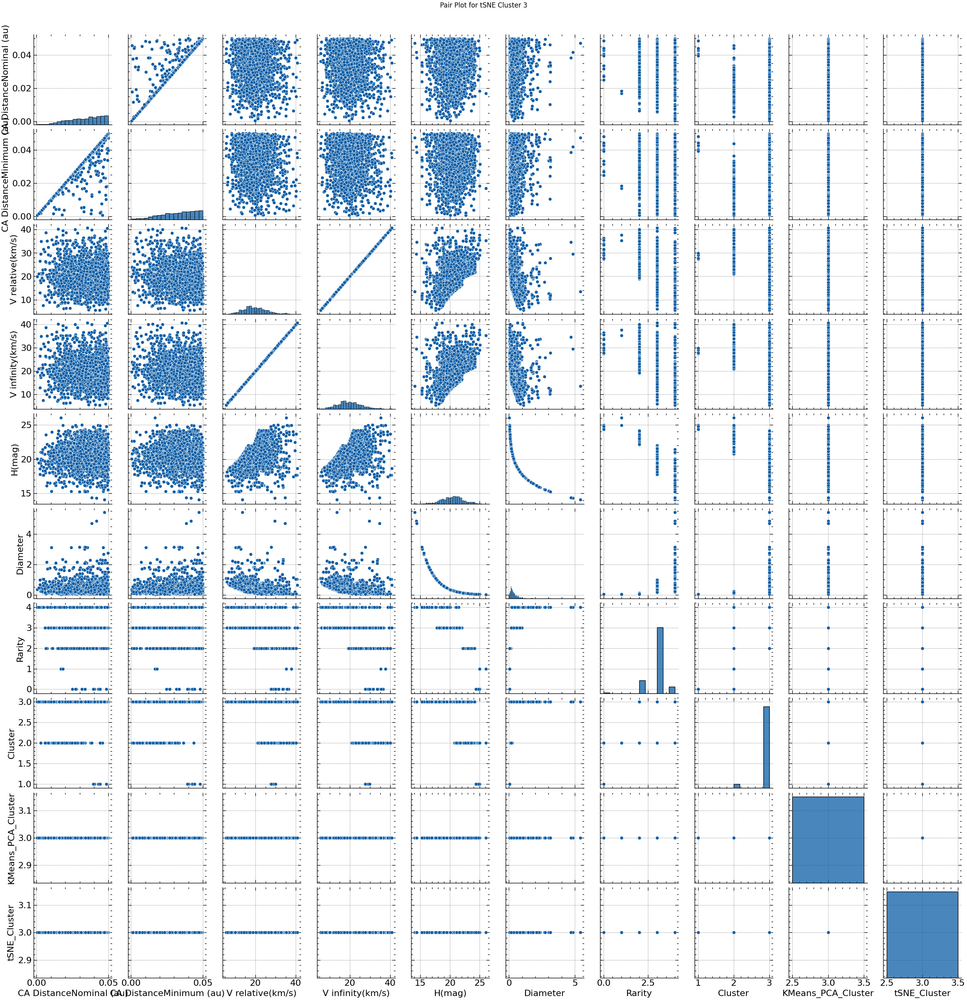



Pair plot for tSNE Cluster 4:


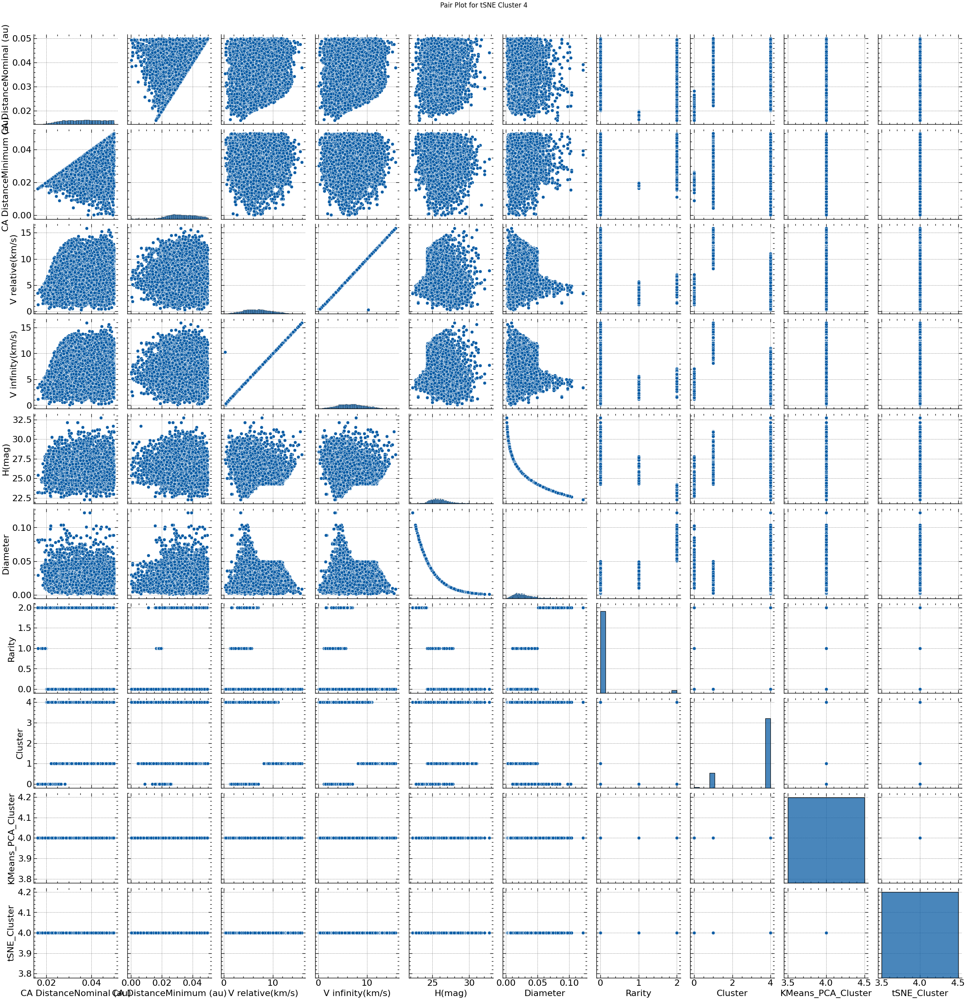

In [ ]:
for cluster_id in sorted(data['tSNE_Cluster'].unique()):
    print(f"Pair plot for tSNE Cluster {cluster_id}:")
    sns.pairplot(data=data[data['tSNE_Cluster'] == cluster_id].copy())
    plt.suptitle(f'Pair Plot for tSNE Cluster {cluster_id}', y=1.02)
    plt.xticks(fontsize=8)
    plt.yticks(fontsize=8)
    plt.show()
    print("\n" + "="*50 + "\n")